# A Fast.ai protein classifier using images

##### version 2.0

#### Paper: [TBD](https://localhost)

#### Dataset: [SHREC 2025: Protein Shape Classification](https://shrec2025.drugdesign.fr/)

#### Other software: [TBD](https://localhost)

Description: this notebook uses 591616 images (32 Gb) captured with `scripts/pyvista-screenshot.py` to train a CNN (e.g. ResNet) to classify proteins.

<!--
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0016-21-7vuy_2:B:A_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0018-15-8rae_1:A:A_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0025-35-6nr9_8:H:H_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0029-38-4yxw_3:G:G_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0032-12-6fyy_21:U:R_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0043-92-7w3a_19:S:s_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0044-18-8pw6_63:WB:l1_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0047-56-5cpk_4:D:D_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0053-81-6qc4_34:RA:B8_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0054-51-5xrt_2:D:D_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0055-84-7nj5_3:C:C_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0056-37-4u3n_53:AB:M7_model1-0-0.jpg
http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0257-09-7taz_1:A:A_model1-0-0.jpg
-->

<table>
    <tr>
        <td><center>21</center></td>
        <td><center>15</center></td>
        <td><center>35</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0016-21-7vuy_2:B:A_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0018-15-8rae_1:A:A_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0025-35-6nr9_8:H:H_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>38</center></td>
        <td><center>12</center></td>
        <td><center>92</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0029-38-4yxw_3:G:G_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0032-12-6fyy_21:U:R_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0043-92-7w3a_19:S:s_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>56</center></td>
        <td><center>81</center></td>
        <td><center>51</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0047-56-5cpk_4:D:D_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0053-81-6qc4_34:RA:B8_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0054-51-5xrt_2:D:D_model1-0-0.jpg"></img>
        </td>
    </tr>
    <tr>
        <td><center>84</center></td>
        <td><center>37</center></td>
        <td><center>09</center></td>
    </tr>
    <tr>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0055-84-7nj5_3:C:C_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0056-37-4u3n_53:AB:M7_model1-0-0.jpg"></img>
        </td>
        <td>
            <img width="100%" height="100%" src="http://deeplearning.ge.imati.cnr.it/shrec-2025-protein-classification/pics/0257-09-7taz_1:A:A_model1-0-0.jpg"></img>
        </td>
    </tr>
</table>

In [1]:
env = dict()
env['use_dataparallel'] = False

import os
if env['use_dataparallel']:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'

In [2]:
!nvidia-smi

Mon Apr  7 12:03:45 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.127.05             Driver Version: 550.127.05     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA RTX A6000               Off |   00000000:01:00.0 Off |                    0 |
| 30%   45C    P8             39W /  300W |     215MiB /  46068MiB |      1%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# Import-initialization


%matplotlib inline

or

%matplotlib notebook

In [3]:
!pwd

/mnt/raid1/repos/shrec2025/Protein_Classification/notebooks


In [4]:
!echo $HOME

/home/biagio


In [5]:
!ls

backups
models
shrec-2025-protein-classification-via-images.ipynb
shrec-2025-protein-classification-via-images-v2.0.ipynb
shrec-2025-protein-classification-via-images-v2.1-inference.ipynb
shrec_run-GPU-balancing_in_dataset.ipynb
wandb


In [6]:
!pip -V

pip 24.3.1 from /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/pip (python 3.12)


In [7]:
!pip list | grep -i "fastai\|semtorch\|Pillow\|torch" # remember that Pillow >= 8.3.0 causes 'RuntimeError: Could not infer dtype of PILImage' while building the DataLoader

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330
fastai                        2.7.19
pillow                        10.4.0
torch                         2.5.1
torchaudio                    2.5.1
torchsde                      0.2.6
torchvision                   0.20.1


In [8]:
def get_pkg_ver(pkg_name):
    import subprocess
    pkg_ver = subprocess.check_output(["/bin/bash", '-c', 'pip list | grep -iw "'+pkg_name+'" | awk "{print \\$2}"'])
    return str(pkg_ver.decode()).replace('\n','')

In [9]:
get_pkg_ver('torch')

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330


'2.5.1'

In [10]:
env['problem'] = 'classification'
#env['problem'] = 'segmentation'
#env['problem'] = 'regression'

if env['problem'] == 'segmentation':
    !pip install semtorch

!pip install --upgrade albumentations

!pip show fastai

from fastai.basics import *
from fastai.vision import models
from fastai.vision.all import *
from fastai.metrics import *
from fastai.data.all import *
from fastai.callback import *

if env['problem'] == 'segmentation':
    # SemTorch
    import semtorch
    from semtorch import get_segmentation_learner

from pathlib import Path
import random
import numpy as np

# Display larger jupyter cells!
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

if env['use_dataparallel']:
    from fastai.distributed import *
    cuda_training_device = 0           # otherwise: RuntimeError: module must have its parameters and buffers on device cuda:0 (device_ids[0]) but found one of them on device: cuda:1
else:
    pass
    #cuda_training_device = 1           # the device of your choice
    
print(f'{torch.cuda.is_available() = }')

DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330

[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
DEPRECATION: Loading egg at /mnt/raid1/venvs/sam2/lib/python3.12/site-packages/MultiScaleDeformableAttention-1.0-py3.12-linux-x86_64.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330
Name: fastai
Version: 2.7.19
Summary: fastai simplifies training fast and accurate neural nets using modern best practices
Home-page: https://github.com/fastai/fastai
Author: Jeremy Howard, Sylvain Gugger, and contributors
Author-e

/tmp/ipykernel_531254/3621787404.py:38: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython.display
  from IPython.core.display import display, HTML


torch.cuda.is_available() = True


In [11]:
import torch
torch.zeros(1).cuda()

tensor([0.], device='cuda:0')

# Determinism


In [12]:
from datetime import datetime

env['seed'] = 2025
env['launch_time'] = datetime.now().strftime('%Y-%m-%d_%H.%M.%S')

random.seed(env['seed'])
set_seed(env['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Secondary Functions


Get filenames both for images and masks

In [13]:
#export
def get_y_fn(img_fn):
    if 'mask' in str(img_fn):
        print(f'Warning! {img_fn} looks like a mask!')
    return Path(str(img_fn).replace("images", "masks").replace('.jpg', '.png'))

#export
def get_x_fns(path, folders, debug=False):
    new_fns = []
    for dset_dir in folders:
        fns = get_image_files(path / dset_dir)
        for fn in fns:
            if not 'mask' in str(fn):
                new_fns.append(fn)
    if debug:
        fn_name = inspect.currentframe().f_code.co_name
        print(f'{fn_name} - {len(new_fns)} - {new_fns}')
    return new_fns

In [14]:
# Given the filename of an image, produce its categorical label (shape or spline)
#export
def img2lbl(img_fn, debug=False):
    pathfn = Path(img_fn)
    return pathfn.parent.name

classification_getter = [
                            lambda o: o,
                            lambda o: img2lbl(o),
                        ]

Aux Functions



In [15]:
# dataset/train, dataset/valid
def ValidParentSplitter(x):
    return str(Path(x).parent.name) == str(env['validation_dir'])

# dataset/train/images, dataset/train/masks, dataset/valid/images, dataset/valid/masks
def ValidGrandParentSplitter(x):
    return str(Path(x).parent.parent.name) == env['validation_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/valid/images, dataset/subdataset/valid/masks
def ValidGrandGrandParentSplitter(x):
    return str(Path(x).parent.parent.parent.name) == env['validation_dir'].name


# dataset/train, dataset/test
def TestParentSplitter(x):
    return str(Path(x).parent.name) == str(env['testing_dir'])

# dataset/train/images, dataset/train/masks, dataset/test/images, dataset/test/masks
def TestGrandParentSplitter(x):
    return str(Path(x).parent.parent.name) == env['testing_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/test/images, dataset/subdataset/test/masks
def TestGrandGrandParentSplitter(x):
    return str(Path(x).parent.parent.parent.name) == env['testing_dir'].name

Early Stopping parameters

In [16]:
env['monitor_training']   = "valid_loss"
env['comp_training']      = np.less

env['monitor_evaluating'] = "f1-score"
env['comp_evaluating']    = np.greater

env['patience']           = 2

env['splits']             = [ 'training', 'validation' ]

Augmentations 

In [17]:
import cv2

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

# Get and setup dataset


In [19]:
import socket
hostname=socket.gethostname()
print(f'{hostname = }')

hostname = 'crushinator'


In [20]:
if 'crushinator' in hostname:
    basepath       = '/mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots'
elif 'zapp-brannigan' in hostname:
    basepath       = '/mnt/btrfs-big/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots'
else:
    print(f'Unknown hostname! {hostname}')

!ls "{basepath}"

00  05	10  15	20  25	30  35	40  45	50  55	60  65	70  75	80  85	90  95
01  06	11  16	21  26	31  36	41  46	51  56	61  66	71  76	81  86	91  96
02  07	12  17	22  27	32  37	42  47	52  57	62  67	72  77	82  87	92
03  08	13  18	23  28	33  38	43  48	53  58	63  68	73  78	83  88	93
04  09	14  19	24  29	34  39	44  49	54  59	64  69	74  79	84  89	94


In [23]:
env['orig_img_size'] = (1000, 1000)

In [24]:
#env['img_size_div'] = [2]     # leave them at 500x500 px
#env['batch_sizes']  = [8]    # Nvidia RTX 2070 Super 8 Gb @ 500px
#env['batch_sizes']  = [16]   # Nvidia RTX 2070 Super 8 Gb @ 250px
#env['batch_sizes']  = [32]    # Nvidia RTX 2070 Super 8 Gb @ 250px
#env['batch_sizes']  = [96]   # Nvidia Quadro 6000 24 Gb

env['img_size_div'] = [3.125] # 320 px
env['batch_sizes']  = [64]    # single Nvidia RTX A6000 @ 320px

In [25]:
env['project_name']   = 'shrec-2025-protein-classification'

env['path'] = Path(basepath)

env['quick-run']      = False    # a way to speed up things for testing purposes
env['no-unfreeze']    = True     # skip the unfreeze step, just fine-tune the regression head using the pretrained model

print(f'Dataset path has been set to: {env["path"]} with this content:\n\n', " ".join([str(i.name) for i in env["path"].ls()]), sep='')

Dataset path has been set to: /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots with this content:

75 14 70 83 86 96 08 34 00 21 74 33 87 20 45 15 66 35 38 62 12 90 60 92 11 18 53 56 17 81 51 84 55 37 16 69 94 91 71 25 65 54 32 22 61 06 46 79 41 05 40 64 88 19 01 93 63 48 59 28 09 31 36 57 43 52 49 76 47 03 13 80 27 85 78 67 07 73 39 95 04 82 58 10 29 77 68 02 24 30 72 23 89 50 44 26 42


In [26]:
if not env['quick-run']:
    fnlist=get_x_fns(folders=['.'], path=env['path'])
    print(f'Found: {len(fnlist)} images')
    
    fn  = fnlist[17]
    cls = img2lbl(fn)
    print(f'{cls} -> {fn}')

Found: 591616 images
75 -> /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/75/0011-75-8shp_9:Q:z_model1-90-45.jpg


In [31]:
import wandb
from fastai.callback.wandb import *

# start logging a wandb run
wandb.init(project=env['project_name'])

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: andrea-ranieri (sburzi) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


# Learning Setup


In [27]:
if env['problem'] == 'segmentation':
    env['segmentation_type'] = "Semantic Segmentation"
    env['arch'] = "deeplabv3+"
    env['backbone'] = "resnet101"
    env['wd'] = 1e-4
    env['n_classes'] = len(codes)
    env['cmap'] = matplotlib.colors.LinearSegmentedColormap.from_list("", ['blue','red','green','black','magenta','yellow','pink','white'])
if env['problem'] == 'classification':
    env['arch'] = "resnet50"
if env['problem'] == 'regression':
    env['arch'] = "resnet101"

#env['num_workers'] = 0     # 20 min per epoch @ bs = 8
#env['num_workers'] = 8     # 12 min  per epoch @ bs = 8
#env['num_workers'] = 16    # 10 min  per epoch @ bs = 8
env['num_workers'] = 32     # 12 min  per epoch @ bs = 8

env['max_images_per_set'] = 100000000000

In [28]:
def is_frozen(learn, debug=False):
    for child in learn.model.children():
        if debug:
            print(child)
        for param in child.parameters():
            if debug:
                print(param.requires_grad)
            if param.requires_grad == False:
                return True, 'a', 'frozen'
    return False, 'b', 'unfrozen'

In [29]:
def show_hyperparams():
    dp_str = ''
    dv_ids = learn.model.device_ids if 'device_ids' in learn.model.__dict__ else ''
    if 'use_dataparallel' in env:
        dp_str = f' - device_ids: {dv_ids}, n_gpu: {torch.cuda.device_count()}'
    print(f'Batch size: {env["bs"]}, image size: {env["img_size"]}, learning rate: {env["lr"]}, round: {env["train_round"]}' + dp_str)

In [30]:
def get_save_fn(env, debug=False):
    part1 = env['project_name'] + '-' + env['arch'] + '-' + (env['backbone'] if env['problem'] == 'segmentation' else '' + '-')
    part2 = env['data-augmentation'] + '-img_size-' + '-'.join(str(x) for x in env['img_size']) + '-'
    part3 = str(env['train_round']) + env['model_frozen_letter']+ '-' + env['launch_time']
    part4 = '-' + 'WD-{str(env["wd"])}' if env['problem'] == 'segmentation' else '' + '-' + 'BS-' + str(env['bs']) + '-'
    part5 = 'LR-' + (str(env['lr'].start) + '-' + str(env['lr'].stop) if type(env['lr']) is slice else str(env['lr']))
    env['save_fn'] = part1 + part2 + part3 + part4 + part5   # at the third unspecified error on a four-lines long instruction, one gives up with the one-linearism
    if debug:
        print(f'save_fn = {env["save_fn"]}')
    return 

In [31]:
class SaveBestAccuracyCallback(TrackerCallback):
    def __init__(self, monitor='accuracy', save_str:str='best-accuracy-model'):
        super().__init__(monitor=monitor) #, reset_on_fit=True)
        self.save_str = save_str
        
    def after_epoch(self):
        super().after_epoch()
        if self.new_best:
            print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
            self.save(f'{self.save_str}-epoch-{self.epoch}-{self.monitor}-{self.best:.4f}')

In [32]:
def fit_one_cycle(env, learn, epochs):
    get_save_fn(env, debug=True)
    
    monitor_training   = env['monitor_training']
    comp_training      = env['comp_training']

    monitor_evaluating = env['monitor_evaluating']
    comp_evaluating    = env['comp_evaluating']

    patience           = env['patience']
    
    callbacks = [
                    ShowGraphCallback(),
                    EarlyStoppingCallback(monitor=monitor_training, comp=comp_training, patience=patience),
                    SaveModelCallback(monitor=monitor_training, comp=comp_training, every_epoch=False, fname=env['save_fn']+'-best'),
                    SaveBestAccuracyCallback(monitor=monitor_training, save_str=env['save_fn']),
                    WandbCallback(),
                ]
    
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"Training in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        !nvidia-smi
    else:    
        learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        
    #show_results(env, learn)

In [33]:
env['splitter'] = None        # in alloc_datablock if splitter is None, RandomSplitter is used

In [34]:
def alloc_datablock(env_, splitter=None, training_dir=None, valid_dir=None):
    status_str = f"Running with {env_['data-augmentation']} - {env_['img_size'] = } - {env_['bs'] = }"
    print(len(status_str) * '-')
    print(status_str)
    print(len(status_str) * '-')
    
    splitter = RandomSplitter(valid_pct=0.2, seed=env['seed']) if not splitter else FuncSplitter(splitter)
    
    if env_['problem'] == 'segmentation':
        item_tfms=[Resize(env_['img_size']), TargetMaskConvertTransform()]
    else:
        item_tfms=[Resize(env_['img_size'])]
        
    if env_['data-augmentation']   == 'no-data-aug':
        pass
    elif env_['data-augmentation'] == 'basic-data-aug':
        item_tfms.append(basicTransformPipeline)
    elif env_['data-augmentation'] == 'strong-data-aug':
        item_tfms.append(strongTransformPipeline)
    elif env_['data-augmentation'] == 'augPipeline_1':
        item_tfms.append(augPipeline_1)
    elif env_['data-augmentation'] == 'augPipeline_2':
        item_tfms.append(augPipeline_2)

    folders = [training_dir, valid_dir] if training_dir and valid_dir else ['.']
        
    if env_['problem']   == 'segmentation':
        target  = (MaskBlock(codes))
        y_fn    = get_y_fn
        getters = None
        getitems= partial(get_x_fns, folders=folders)
    elif env_['problem'] == 'classification':
        target  = (CategoryBlock,)
        y_fn    = None
        #getters = classification_regression_getters_class_only
        #getitems= partial(get_image_files_wosplines_full_dataset, splits=[training_dir, valid_dir], max_num_per_class=env['max_images_per_set'])
        getters = classification_getter
        #getitems= partial(get_x_fns, folders=folders) # get_x_fns(folders=folders, path=env['path'])
        getitems= get_image_files
    elif env_['problem'] == 'regression':
        target  = (RegressionBlock,)
        y_fn    = None
        getters = classification_regression_getters_one_param_regression
        getitems= partial(get_image_files_wosplines_full_dataset, splits=folders, max_num_per_class=env_['max_images_per_set'])
    elif env_['problem'] == 'classification-regression':
        target  = (CategoryBlock, RegressionBlock)
        y_fn    = None
        getters = classification_regression_getters
        getitems= partial(get_x_fns, folders=folders)
        
    print(f'Using {target} as target...')
    print(f'Using {splitter} as splitter...')
        
    db = DataBlock(blocks=(ImageBlock, *target),
                   get_items  = getitems,
                   get_y      = y_fn,
                   getters    = getters,
                   splitter   = splitter,
                   item_tfms  = item_tfms,
                   batch_tfms = Normalize.from_stats(*imagenet_stats),
                   n_inp      = 1,                         # This one is really nice: n_inp is what controls what
                                                           # gets ingested by the forward() method!
                                                           # in return forward_call(*input, **kwargs) (at torch/nn/modules/module.py:1190)
                                                           # input is a tuple length n_inp, so if n_inp > 1 it won't match a ResNet-??.forward() signature...
                  )
    db.summary(env_['path'])
    dls = db.dataloaders(env_['path'], bs=env_['bs'], num_workers=env_['num_workers'])
    #show_batch(dls=None, debug=True)

    return dls

In [35]:
def init_learner_classification(env, debug=False):
    env['img_size']    = [int(x / env['img_size_div'][0]) for x in env['orig_img_size']]
    env['bs']          = env['batch_sizes'][0]

    if debug:
        print(Path(env['training_dir']).name, Path(env['validation_dir']).name)
        allfiles = get_train_test_image_files(env['path'])
        print('allfiles', len(allfiles), allfiles)

    dls = alloc_datablock(env, splitter=env['splitter'])
    
    env['n_classes'] = dls.c
    print(f'The classification problem has {dls.c} classes...')
    #dls.show_batch(figsize=(8, 8), vmin=0, vmax=env['n_classes']-1) #, cmap=env['cmap'])
    #show_batch_classification(dls)

    metrics = [
                accuracy,
                Precision(average='macro'),
                Recall(average='macro'),
                F1Score(average='macro'),
                Jaccard(average='macro'),
              ]    
    
    learn = vision_learner(dls, eval(env['arch']), metrics=metrics)
    learn.dls.show_batch(figsize=(38,38))
    
    print(f'Creating learner object with arch: {eval(env["arch"])} and loss function: {learn.loss_func}')
    
    learn.freeze() # Freezing the backbone
    return learn

In [36]:
if env['problem'] == 'classification':
    init_learner = init_learner_classification
if env['problem'] == 'regression':
    init_learner = init_learner_regression

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [320, 320] - env_['bs'] = 64
--------------------------------------------------------------------------
Using (<function CategoryBlock at 0x76f593d3e2a0>,) as target...
Using <function RandomSplitter.<locals>._inner at 0x76f574b2db20> as splitter...
Setting-up type transforms pipelines
Found 591616 items
2 datasets of sizes 473293,118323
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying <lambda> gives
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying 

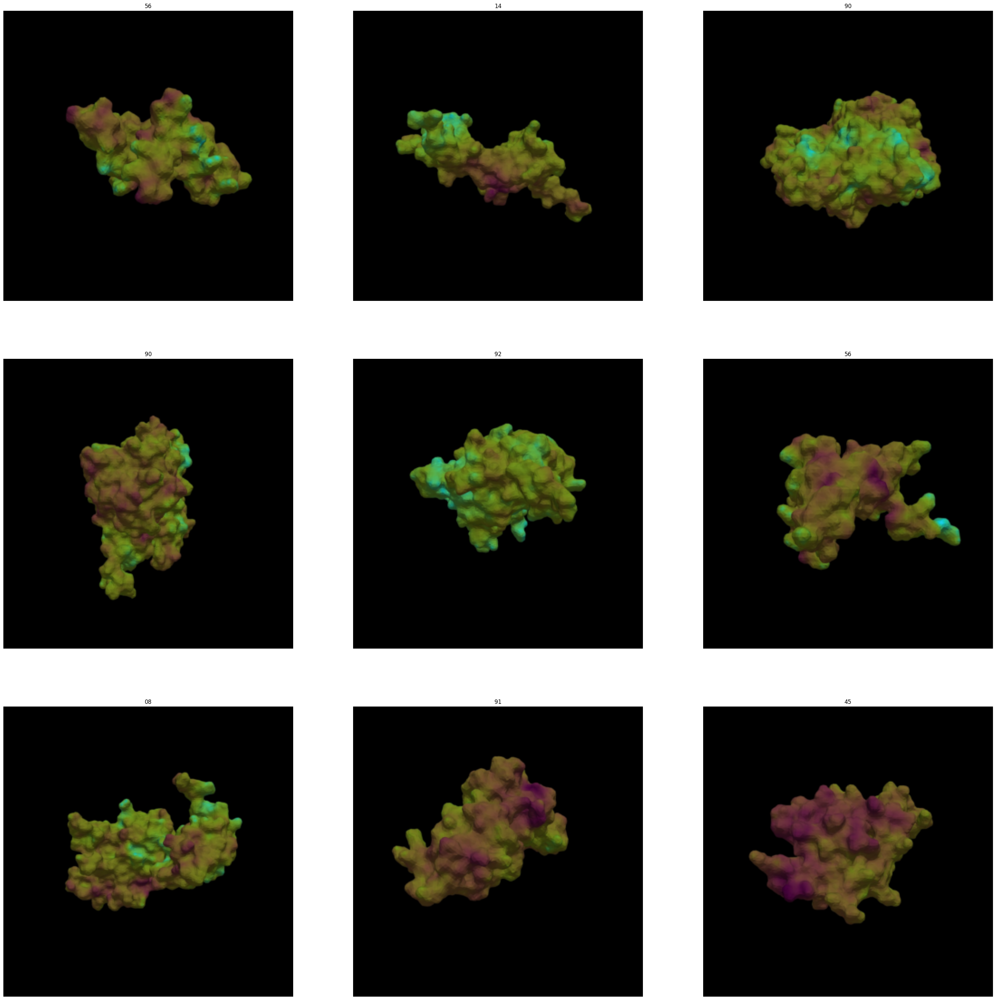

In [37]:
env['data-augmentation'] = 'no-data-aug'
learn = init_learner(env, debug=False)

In [38]:
if env['problem'] == 'classification':
    init_learner = init_learner_classification
    show_batch   = learn.dls.show_batch
    show_results = learn.show_results
if env['problem'] == 'regression':
    init_learner = init_learner_regression
    show_batch   = learn.dls.show_batch
    show_results = learn.show_results

In [39]:
def validate(learn, debug=False):
    neq=50
    print(neq*'=')
    print(neq*'=')
    print(f'Validating, please wait...')
    print(neq*'=')
    metrics = learn.validate()
    if debug:
        print(f'learn.metrics: {learn.metrics}')
        for idx, this_metric in enumerate(learn.metrics):
            print(f'this_metric.name: {this_metric.name}')
        print(f'metrics: {metrics}')
    print(f'Validation completed, printing validation metrics')
    print(neq*'=')
    for idx, metric_score in enumerate(metrics):
        if idx != 0:
            metric_str = str(learn.metrics[idx-1].name)
            print(f'{idx} - {metric_str} = {metric_score}')
        else:
            print(f'{idx} - valid_loss = {metric_score}')
    print(neq*'=')
    print(neq*'=')

In [40]:
import os
def reload_best_model(learn, prefix, debug=False):
    model_dir = learn.path.absolute() / learn.model_dir
    print(f'Looking for {prefix}-*-best models in: {model_dir}')
    print(20*'-')
    files = model_dir.glob(f'{prefix}*-best.pth')
    files = sorted(files, key=os.path.getmtime)
    for i in files:
        print(i)
    print(20*'-')
    print(f'Reloading {i}')
    learn.load(str(i).replace('.pth', ''))
    validate(learn)

In [41]:
def garbage_collect():
    import gc
    gc.collect()
    torch.cuda.empty_cache()

# Define training ground functions

In [42]:
def next_round(env):
    env['train_round'] += 1
    env['img_size']     = [int(env['orig_img_size'][0] / env['img_size_div'][env['train_round']-1])] * 2     
    env['bs']           = env['batch_sizes'][env['train_round']-1]

In [43]:
def do_lr_find_impl(env, learn):
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"LR_finding in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            suggested_lrs = learn.lr_find() # find learning rate
            
        !nvidia-smi
    else:
        suggested_lrs = learn.lr_find()     # find learning rate
    
    learn.recorder                          # plot learning rate graph
    print(f'Suggested LRs: {suggested_lrs}')
    if suggested_lrs is None:
        suggested_lrs = [1e-4, 1e-4]
    return suggested_lrs

In [44]:
def do_lr_find(env, learn, dls):
    learn.dls = dls
    learn.freeze()
    return do_lr_find_impl(env, learn)

In [45]:
def set_lr(env, learn, suggested_lrs):
    # lr_min is the minimum value in the curve plotted by lr_find()   -> this means that it may be 1e-1 or even 1e0 so it's actually 10x or even 100x the "reasonable" lr_max
    # lr_steep is the x coord of the plot where the slope is steepest -> this means that it may be 1e-2 or so, so it's a reasonable value for actual lr_max
    lr_min = min(suggested_lrs[0]/10, 5e-3)
    lr_max = min(suggested_lrs[0]/2,  1e-2)
    lr_min = max(lr_min, 5e-4)
    lr_max = max(lr_max, 1e-3)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [46]:
def train_model(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [47]:
def do_lr_find_unfreeze(env, learn):
    learn.unfreeze()
    return do_lr_find_impl(env, learn)

In [48]:
def set_lr_unfreeze(env, learn, suggested_lrs):
    lr_min = min(suggested_lrs[0]/10, 1e-5)
    lr_max = min(suggested_lrs[0]/2,  1e-4)
    lr_min = max(lr_min, 1e-5)
    lr_max = max(lr_max, 1e-4)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [49]:
def train_model_unfreeze(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [50]:
def do_training_round (env, learn, epochs=10):
    next_round(env)
    dls = alloc_datablock(env)
    
    suggested_lrs = do_lr_find(env, learn, dls)
    set_lr(env, learn, suggested_lrs)
    train_model(env, learn, epochs=epochs)
    
    if not env['no-unfreeze']:
        suggested_lrs = do_lr_find_unfreeze(env, learn)
        set_lr_unfreeze(env, learn, suggested_lrs)
        train_model_unfreeze(env, learn, epochs=epochs)

In [51]:
import matplotlib.pyplot as plt

'''
@patch
def confusion_matrix(self: ClassificationInterpretation):
    print(f'Running patched confusion_matrix() method with {self.vocab = }')
    x = torch.arange(0, len(self.vocab)).cuda()
    _,targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True, with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)

def confusion_matrix(learn, title='Confusion Matrix'):
    interp = ClassificationInterpretation.from_learner(learn)
    #interp.plot_confusion_matrix(figsize=(5,5))
    plt.rcParams.update({'font.size': 32})
    disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))
    return interp
'''

In [52]:
def validate_against_test_set(env, learn):
    dls_test = alloc_datablock(env, splitter=TestGrandGrandParentSplitter, training_dir=env['training_dir'], valid_dir=env['testing_dir'])
    learn.dls = dls_test
    learn.freeze()
    validate(learn)

In [53]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [54]:
learn.summary()

Sequential (Input shape: 64 x 3 x 320 x 320)
Layer (type)         Output Shape         Param #    Trainable 
                     64 x 64 x 160 x 160 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     64 x 64 x 80 x 80   
MaxPool2d                                                      
Conv2d                                    4096       False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
____________________________________________________________________________
                     64 x 256 x 80 x 80  
Conv2d                                    16384      False     
BatchNorm2d                        

In [55]:
if env['problem'] == 'regression':
    print(learn.loss_func)

In [68]:
please_stop_here_with_an_error

NameError: name 'please_stop_here_with_an_error' is not defined

# No data Aug


## Round 1

In [193]:
env['train_round']       = 0
env['data-augmentation'] = 'no-data-aug'

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [320, 320] - env_['bs'] = 64
--------------------------------------------------------------------------
Using (<function CategoryBlock at 0x724695df6160>,) as target...
Using <function RandomSplitter.<locals>._inner at 0x7245fd32d800> as splitter...
Setting-up type transforms pipelines
Found 591616 items
2 datasets of sizes 473293,118323
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying <lambda> gives
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying 

Suggested LRs: SuggestedLRs(valley=0.0005754399462603033)
Setting LRs to: slice(0.0005, 0.001)
save_fn = shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001
Batch size: 64, image size: [320, 320], learning rate: slice(0.0005, 0.001, None), round: 1 - device_ids: , n_gpu: 1
save_fn = shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001


epoch,train_loss,valid_loss,accuracy,precision_score,recall_score,f1_score,jaccard_score,time
0,1.168506,0.951805,0.700447,0.502297,0.397622,0.394060,0.298121,34:47
1,0.770923,0.622968,0.778572,0.674918,0.527047,0.538854,0.437100,33:55
2,0.631994,0.499476,0.813899,0.759711,0.626299,0.642164,0.540022,33:55
3,0.551565,0.433282,0.837293,0.815280,0.680460,0.705828,0.605481,33:53
4,0.491420,0.385433,0.857035,0.870401,0.747867,0.778474,0.681956,33:52
5,0.425703,0.356571,0.863856,0.897922,0.753211,0.785512,0.698760,33:51
6,0.393998,0.324121,0.876524,0.903269,0.792079,0.819822,0.737597,33:54
7,0.360885,0.305040,0.885221,0.910311,0.807480,0.836508,0.758361,34:11
8,0.319777,0.296199,0.889396,0.916427,0.820070,0.848664,0.773535,33:57
9,0.314338,0.294796,0.889278,0.916302,0.817060,0.845639,0.770427,33:57


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 0 with valid_loss value: 0.9518051147460938.
Better model found at epoch 0 with valid_loss value: 0.9518051147460938.


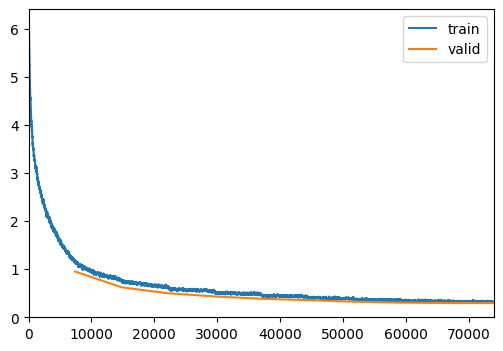

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 1 with valid_loss value: 0.6229677796363831.
Better model found at epoch 1 with valid_loss value: 0.6229677796363831.


/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 2 with valid_loss value: 0.49947601556777954.
Better model found at epoch 2 with valid_loss value: 0.49947601556777954.


/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 3 with valid_loss value: 0.43328166007995605.
Better model found at epoch 3 with valid_loss value: 0.43328166007995605.
Better model found at epoch 4 with valid_loss value: 0.3854331970214844.
Better model found at epoch 4 with valid_loss value: 0.3854331970214844.
Better model found at epoch 5 with valid_loss value: 0.3565712869167328.
Better model found at epoch 5 with valid_loss value: 0.3565712869167328.
Better model found at epoch 6 with valid_loss value: 0.32412075996398926.
Better model found at epoch 6 with valid_loss value: 0.32412075996398926.
Better model found at epoch 7 with valid_loss value: 0.30503952503204346.
Better model found at epoch 7 with valid_loss value: 0.30503952503204346.
Better model found at epoch 8 with valid_loss value: 0.2961990535259247.
Better model found at epoch 8 with valid_loss value: 0.2961990535259247.
Better model found at epoch 9 with valid_loss value: 0.29479604959487915.
Better model found at epoch 9 with valid_los

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/fastai/learner.py:67: UserWarning: Saved file doesn't contain an optimizer state.
  elif with_opt: warn("Saved file doesn't contain an optimizer state.")


Validation completed, printing validation metrics
0 - valid_loss = 0.29479604959487915
1 - accuracy = 0.8892776370048523
2 - precision_score = 0.9163019530147519
3 - recall_score = 0.8170595946456862
4 - f1_score = 0.8456388255966915
5 - jaccard_score = 0.7704270257515108


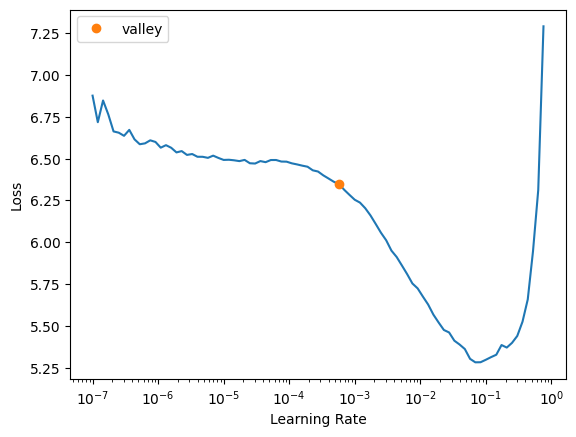

In [194]:
do_training_round(env, learn, epochs=10)

### Reload the best model
According to one own metric's (e.g. considering also how close to overfit the model could be)

In [57]:
learn.load('shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001-epoch-8-valid_loss-0.2962', weights_only=False)

### Perform validation against the validation set...

In [58]:
validate(learn)

Validating, please wait...


Validation completed, printing validation metrics
0 - valid_loss = 0.2961990535259247
1 - accuracy = 0.8893959522247314
2 - precision_score = 0.9164268423675769
3 - recall_score = 0.8200702331151302
4 - f1_score = 0.84866352345916
5 - jaccard_score = 0.7735351409153001


##### Export for easier reload in inference script

In [63]:
import dill # this is to avoid: “PicklingError: Can’t pickle <function <lambda>”

In [64]:
learn.export('shrec-2025-protein-classification-resnet50--no-data-aug-img_size-320-320-1a-2025-04-04_12.15.05-BS-64-LR-0.0005-0.001-epoch-8-valid_loss-0.2962.pkl', pickle_module=dill)

### Show confusion matrix and top losses for the validation set

In [77]:
dls = alloc_datablock(env, splitter=env['splitter'])

--------------------------------------------------------------------------
Running with no-data-aug - env_['img_size'] = [320, 320] - env_['bs'] = 64
--------------------------------------------------------------------------
Using (<function CategoryBlock at 0x76f593d3e2a0>,) as target...
Using <function RandomSplitter.<locals>._inner at 0x76f5017d4c20> as splitter...
Setting-up type transforms pipelines
Found 591616 items
2 datasets of sizes 473293,118323
Setting up Pipeline: <lambda> -> PILBase.create
Setting up Pipeline: <lambda> -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: <lambda> -> PILBase.create
    starting from
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying <lambda> gives
      /mnt/raid1/datasets/shrec-2025-protein-classification/v2-20250331/train-labeled-screenshots/14/7730-14-8rbx_18:W:V_model1-315-90.jpg
    applying 

In [117]:
@patch
def confusion_matrix(self: ClassificationInterpretation):
    print(f'Running patched confusion_matrix() method with {self.vocab = }')
    x = torch.arange(0, len(self.vocab)) #.cuda()
    _,targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True, with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)

def confusion_matrix(learn, title='Confusion Matrix'):
    interp = ClassificationInterpretation.from_learner(learn)
    #interp.plot_confusion_matrix(figsize=(5,5))
    plt.rcParams.update({'font.size': 8})
    disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))
    return interp

In [74]:
'''
@patch
def confusion_matrix(self: ClassificationInterpretation):
    "Confusion matrix as an `np.ndarray`."
    x = torch.arange(0, len(self.vocab))
    targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True,  with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)
def confusion_matrix(learn, title='Confusion Matrix'):
    interp = ClassificationInterpretation.from_learner(learn)
    #interp.plot_confusion_matrix(figsize=(5,5))
    plt.rcParams.update({'font.size': 12})
    disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))
    return interp
'''

In [85]:
learn.dls = dls

The classification problem has 97 classes: ['00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96']


Running patched confusion_matrix() method with self.vocab = ['00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96']


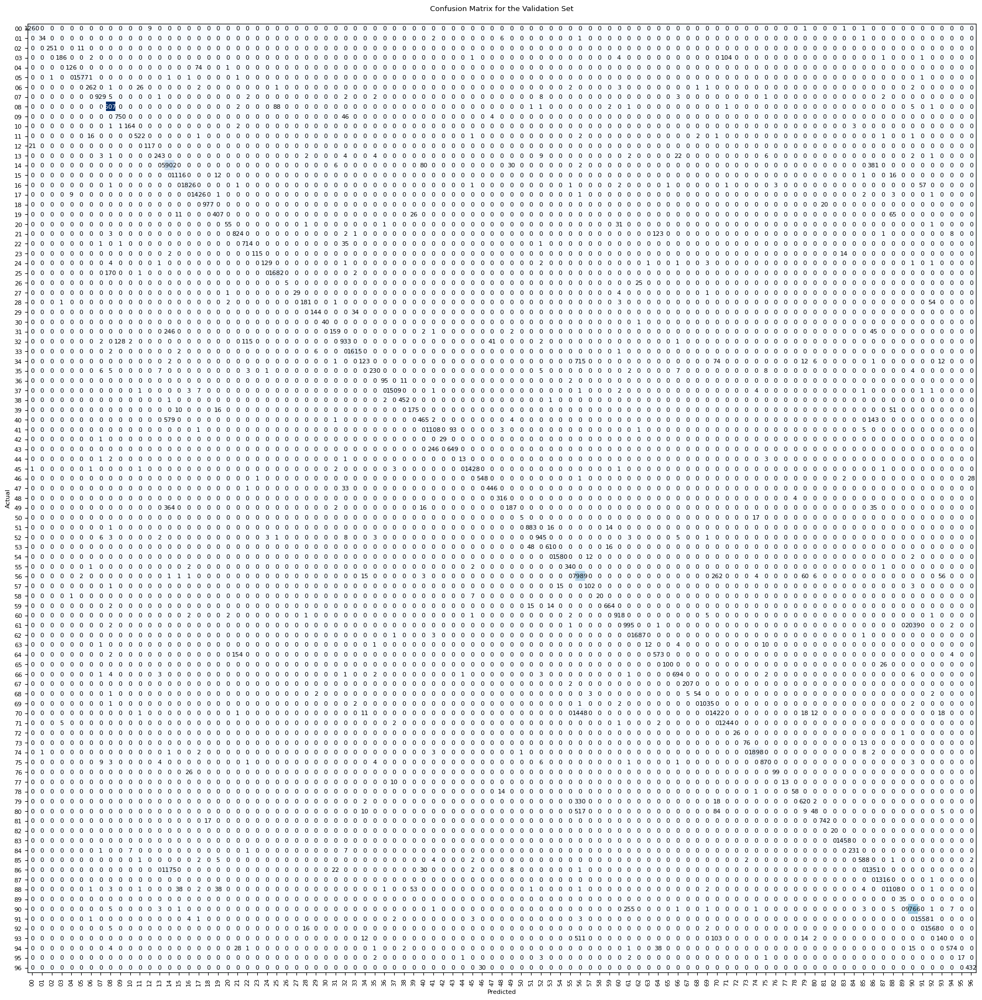

In [118]:
if env['problem'] == 'classification':
    print(f'The classification problem has {learn.dls.c} classes: {learn.dls.vocab}')
    interp = confusion_matrix(learn, title='Confusion Matrix for the Validation Set\n')

In [87]:
interp = ClassificationInterpretation.from_learner(learn)

In [80]:
'''
@patch
def confusion_matrix(self: ClassificationInterpretation):
    print(f'Running patched confusion_matrix() method with {self.vocab = }')
    x = torch.arange(0, len(self.vocab)).cuda()
    _,targs,decoded = self.learn.get_preds(dl=self.dl, with_decoded=True, with_preds=True, with_targs=True, act=self.act)
    d,t = flatten_check(decoded, targs)
    cm = ((d==x[:,None]) & (t==x[:,None,None])).long().sum(2)
    return to_np(cm)
'''

Running patched confusion_matrix() method with self.vocab = ['00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96']


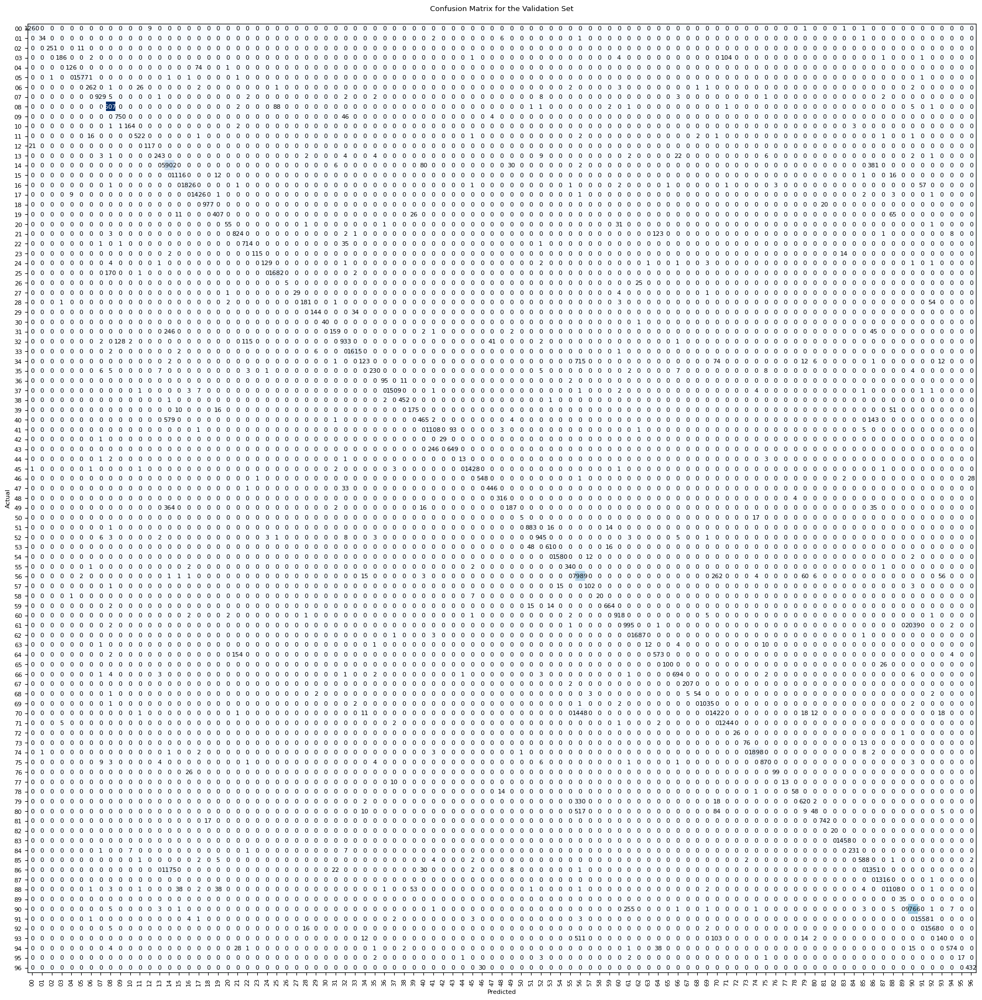

In [116]:
title='Confusion Matrix for the Validation Set\n'
#interp.plot_confusion_matrix(figsize=(5,5))
plt.rcParams.update({'font.size': 8})
disp = interp.plot_confusion_matrix(title=title, cmap=plt.cm.Blues, normalize=False, figsize=(19,18))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


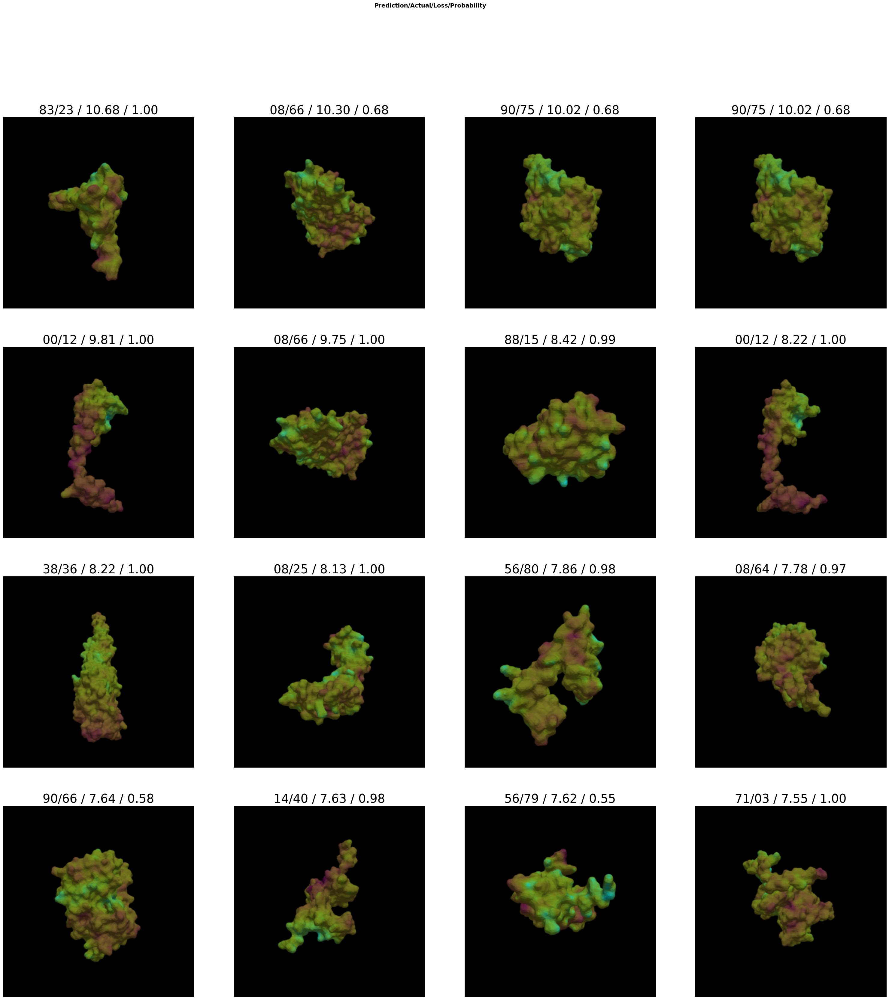

In [89]:
if env['problem'] == 'classification':
    plt.rcParams.update({'font.size': 24})
    interp.plot_top_losses(16, figsize=(38,38), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1)

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


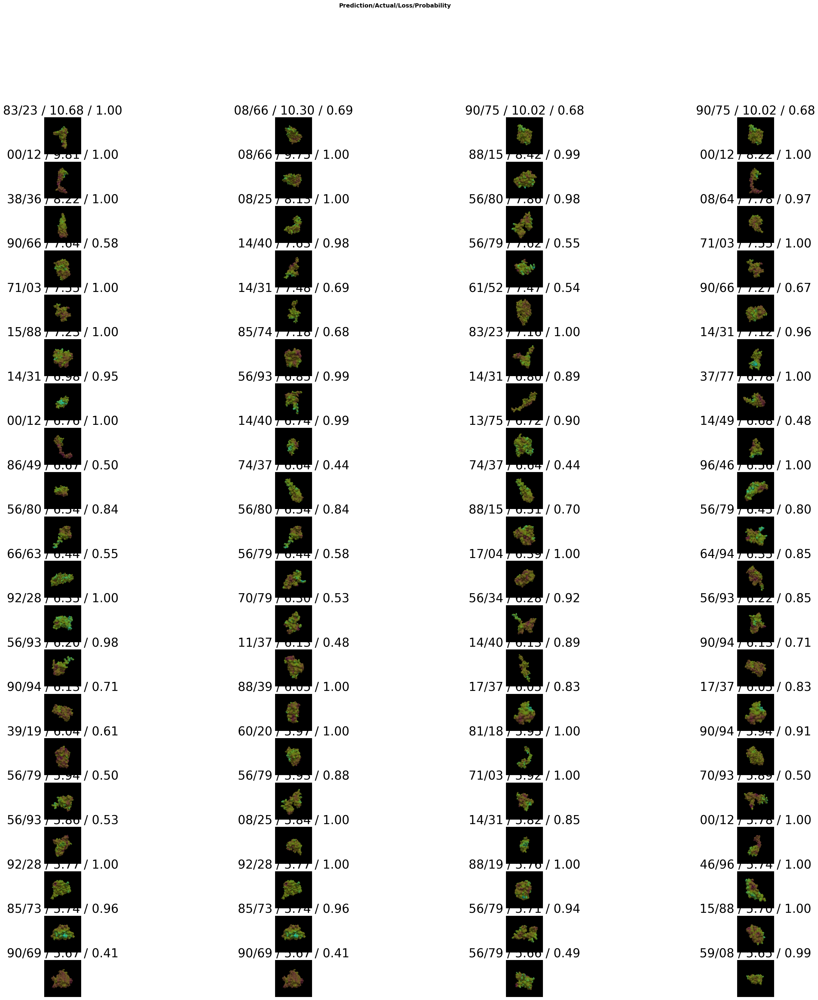

In [91]:
if env['problem'] == 'classification':
    plt.rcParams.update({'font.size': 24})
    interp.plot_top_losses(80, figsize=(38,38), ncols=4, nrows=20, vmin=0, vmax=env['n_classes']-1)

### Show prediction quality against the validation set

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


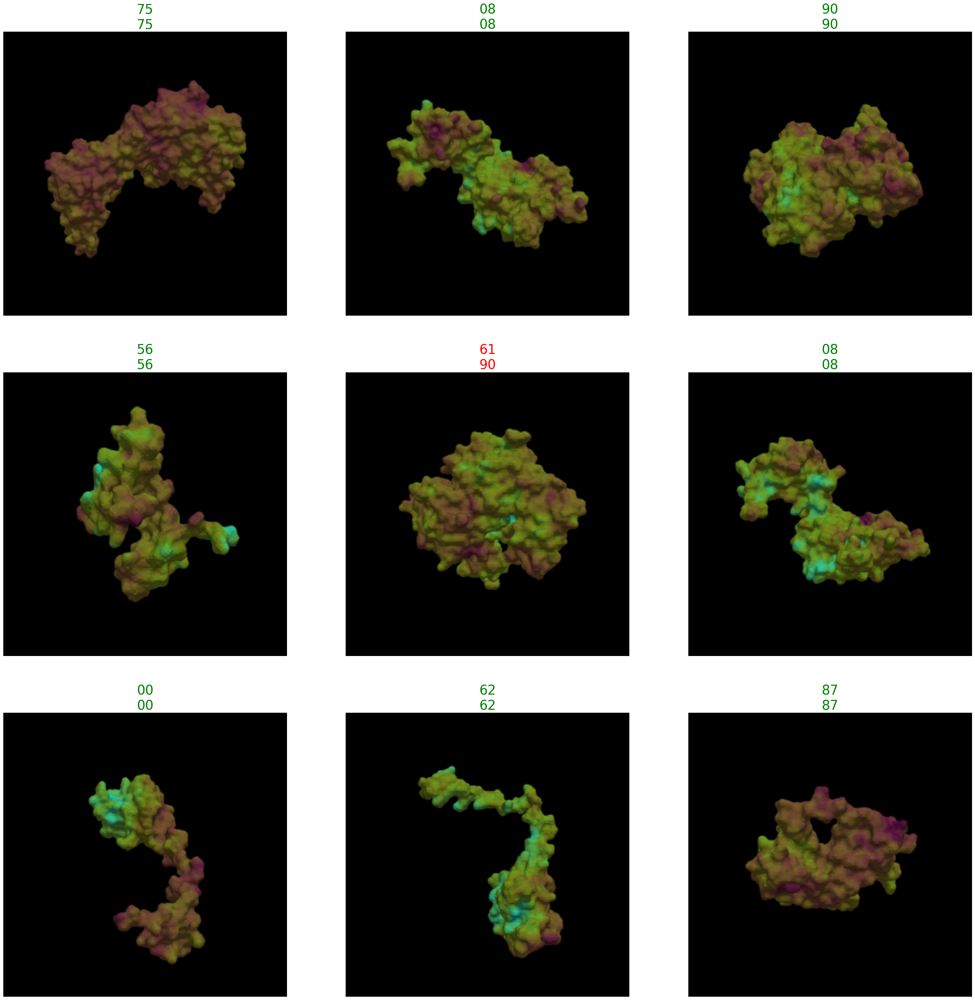

In [92]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


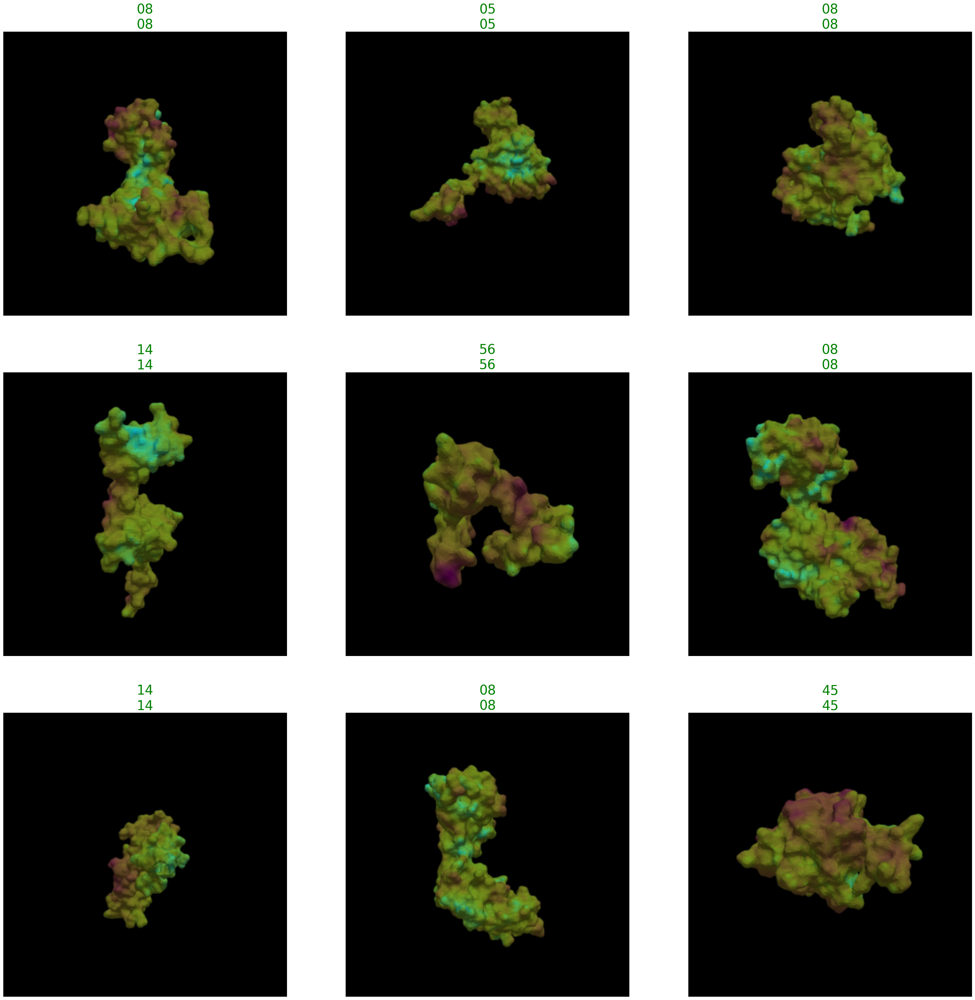

In [93]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


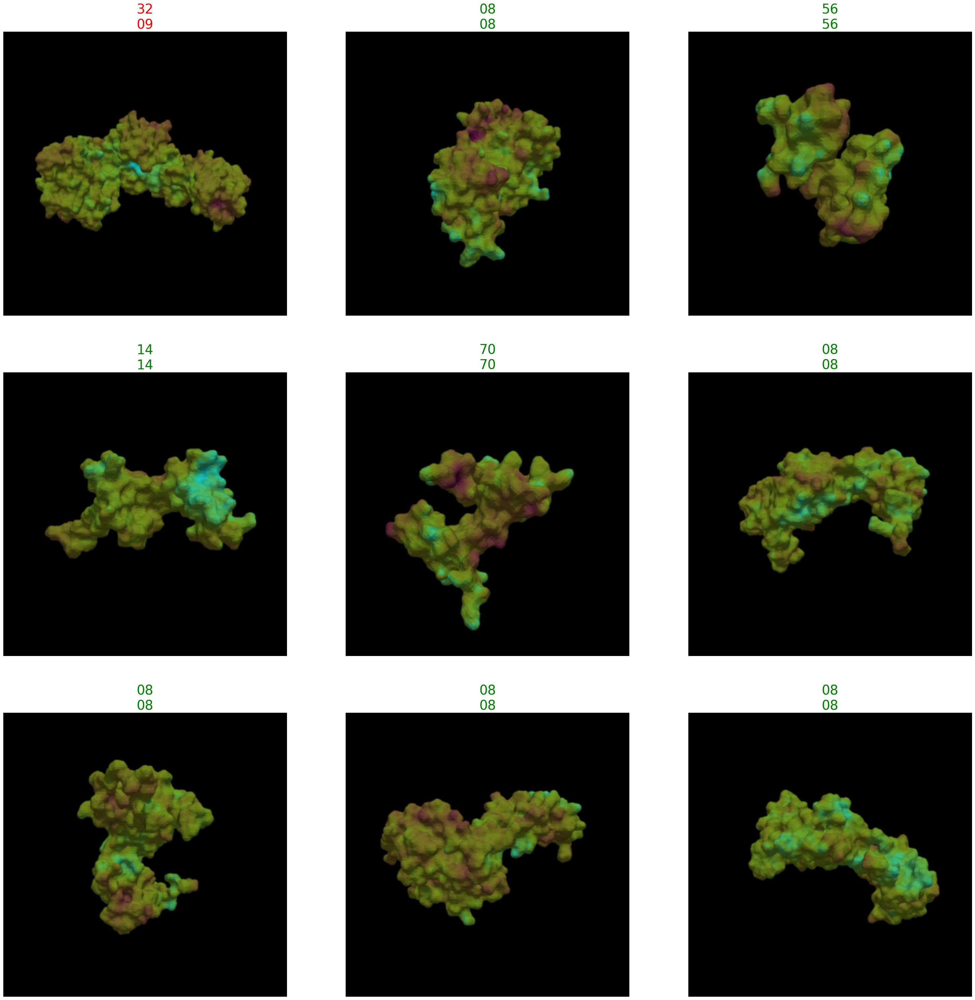

In [94]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


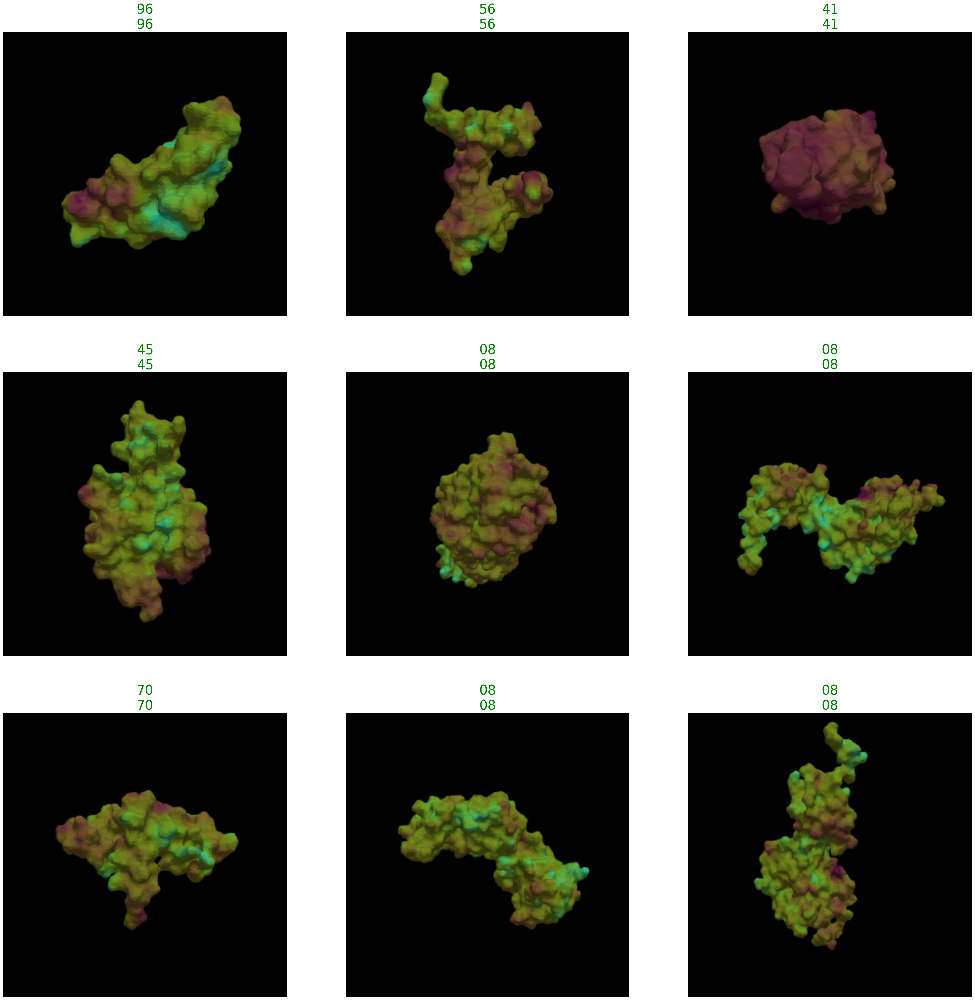

In [95]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


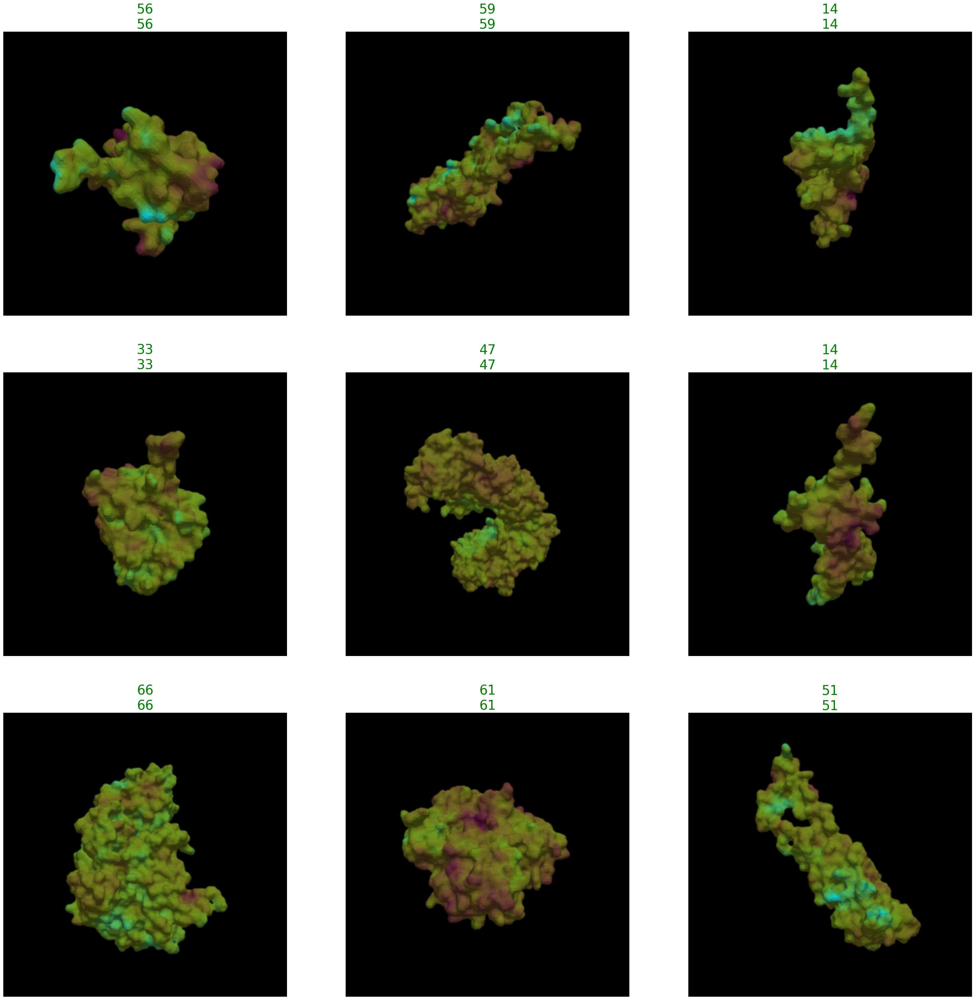

In [96]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


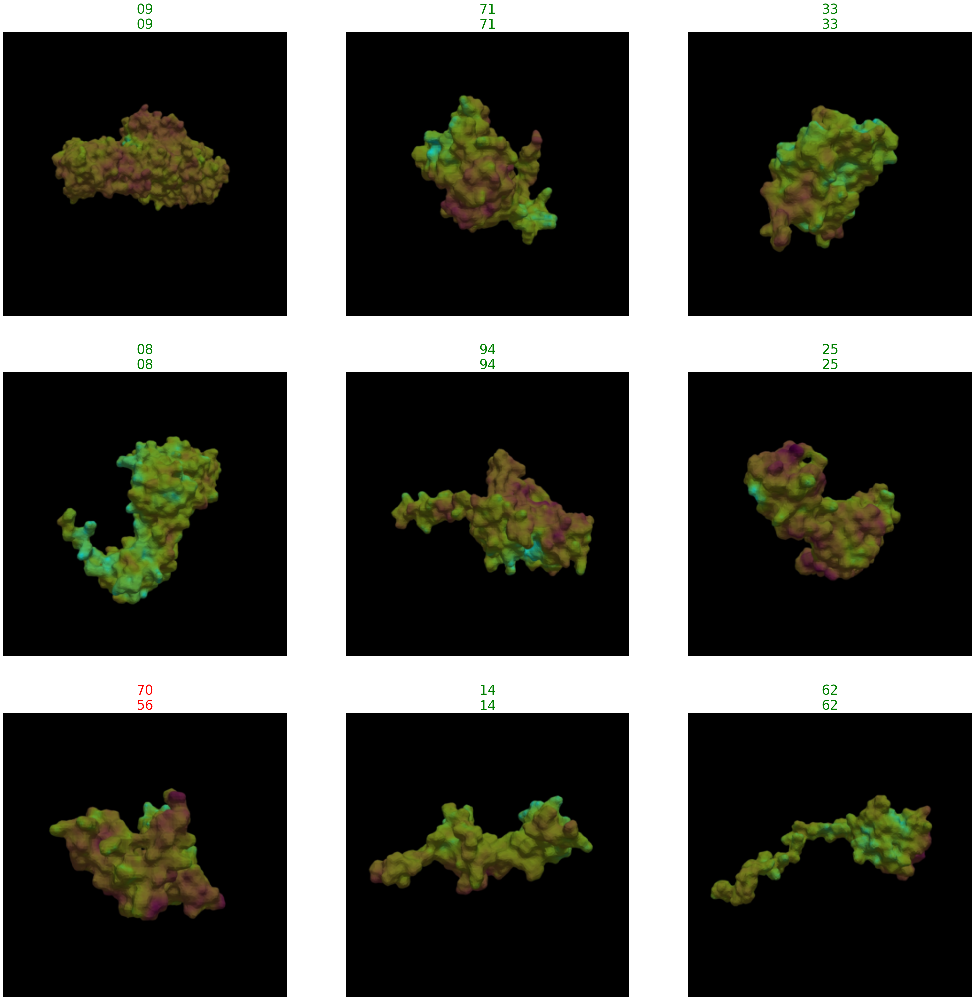

In [97]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


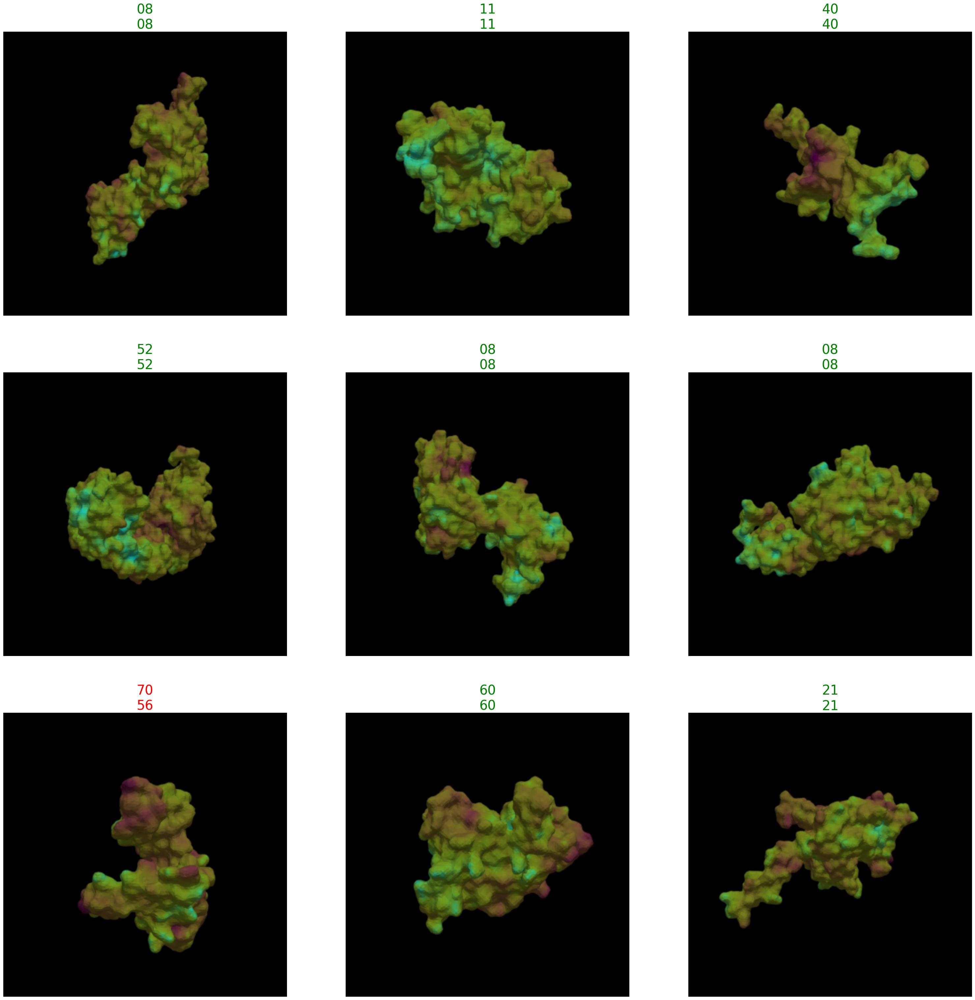

In [98]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


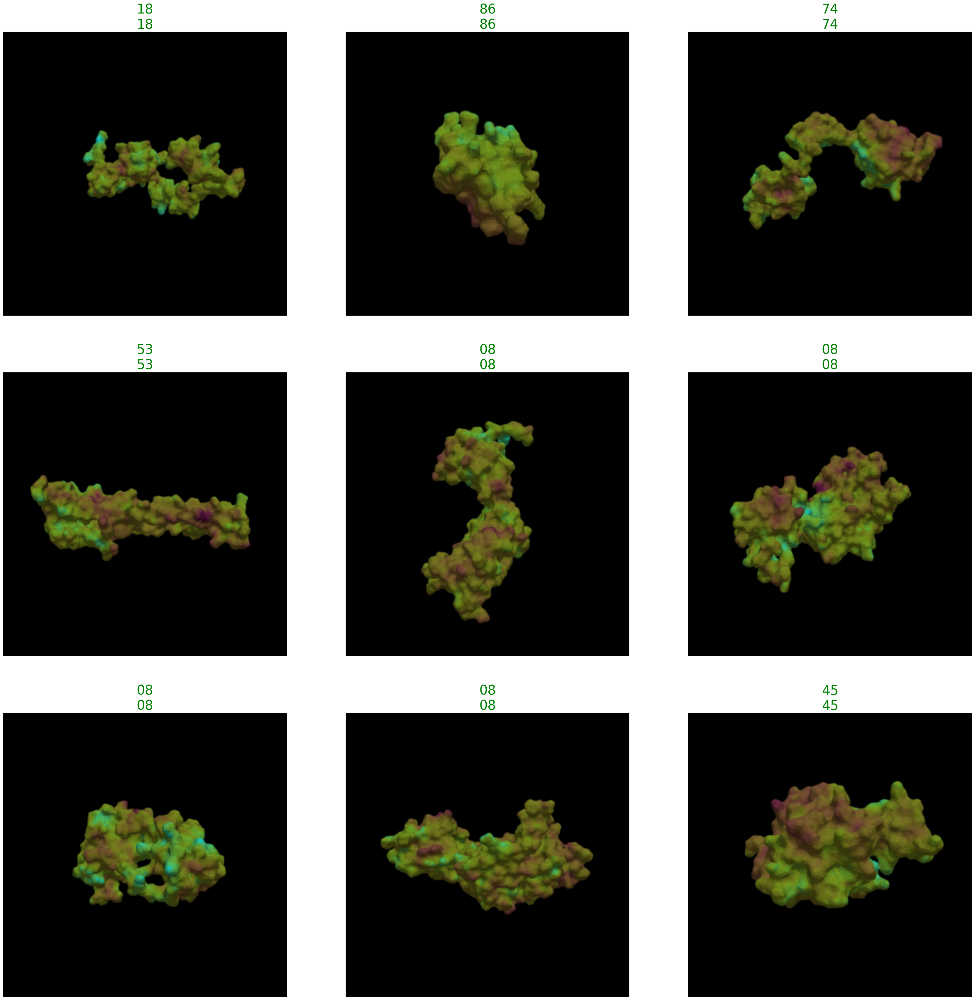

In [99]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


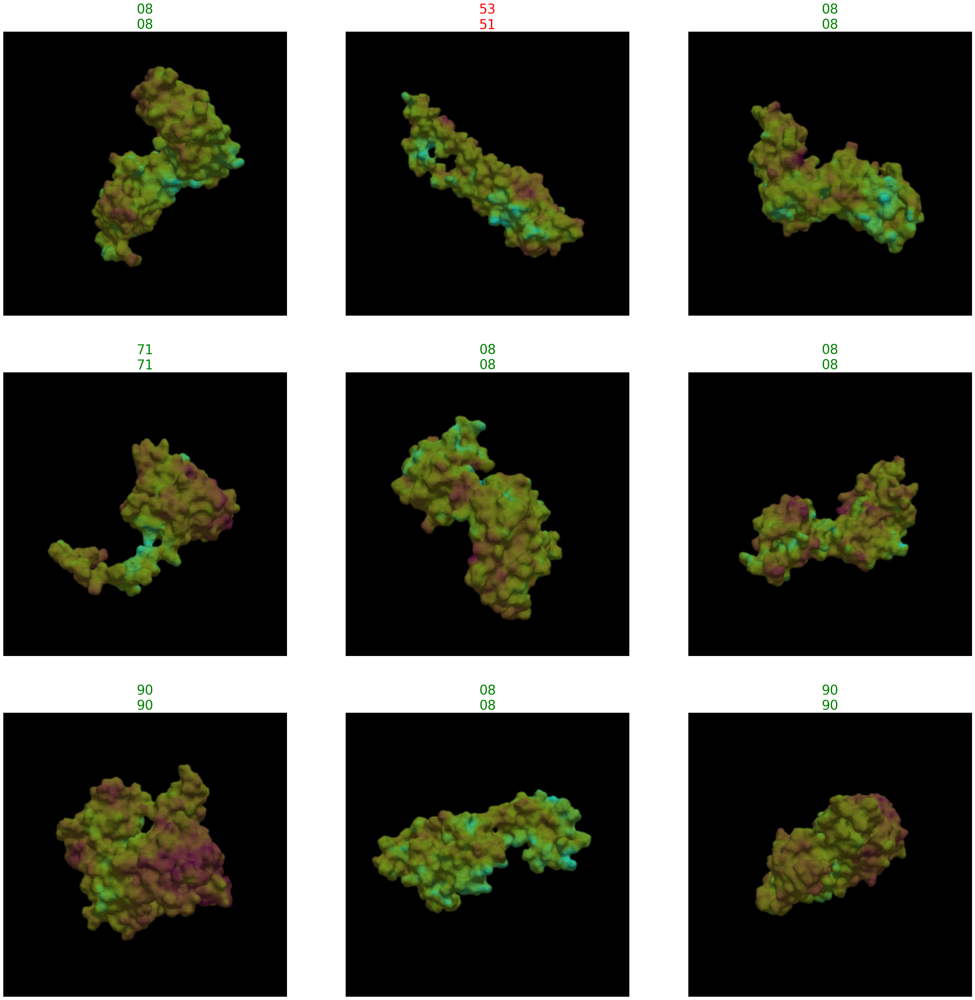

In [100]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


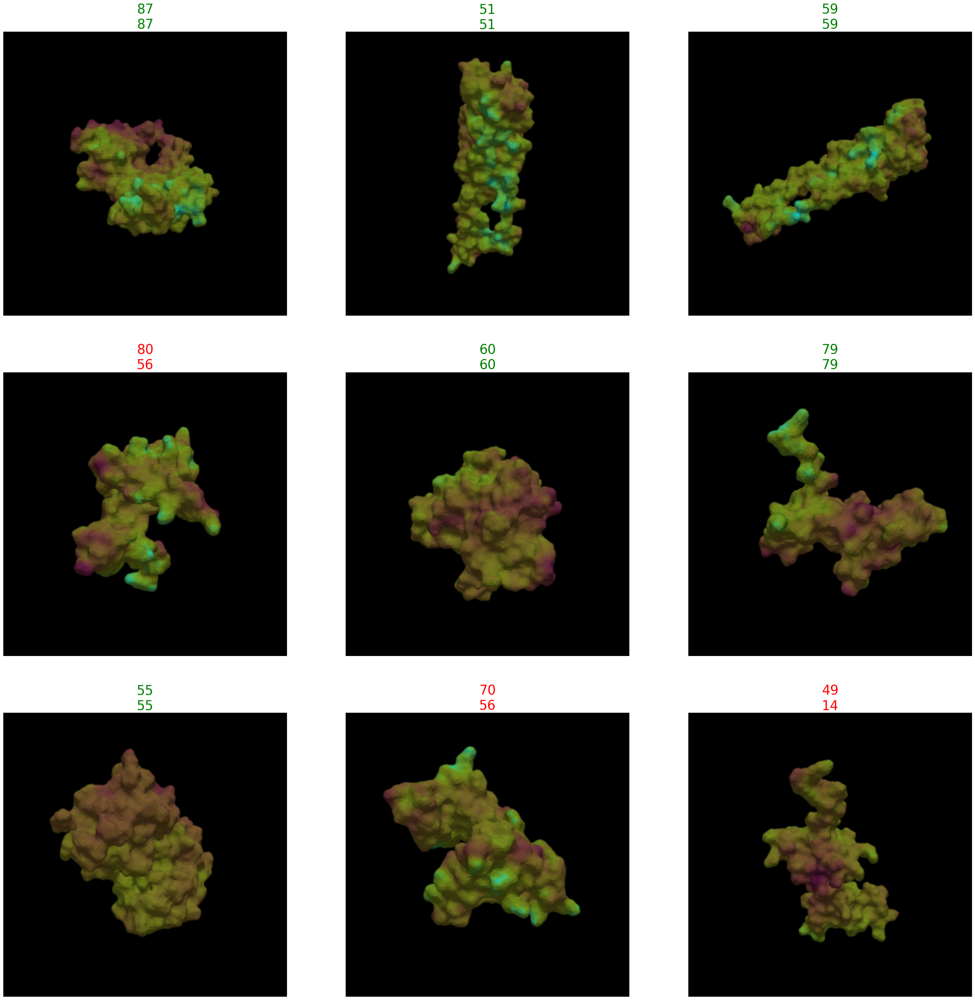

In [101]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


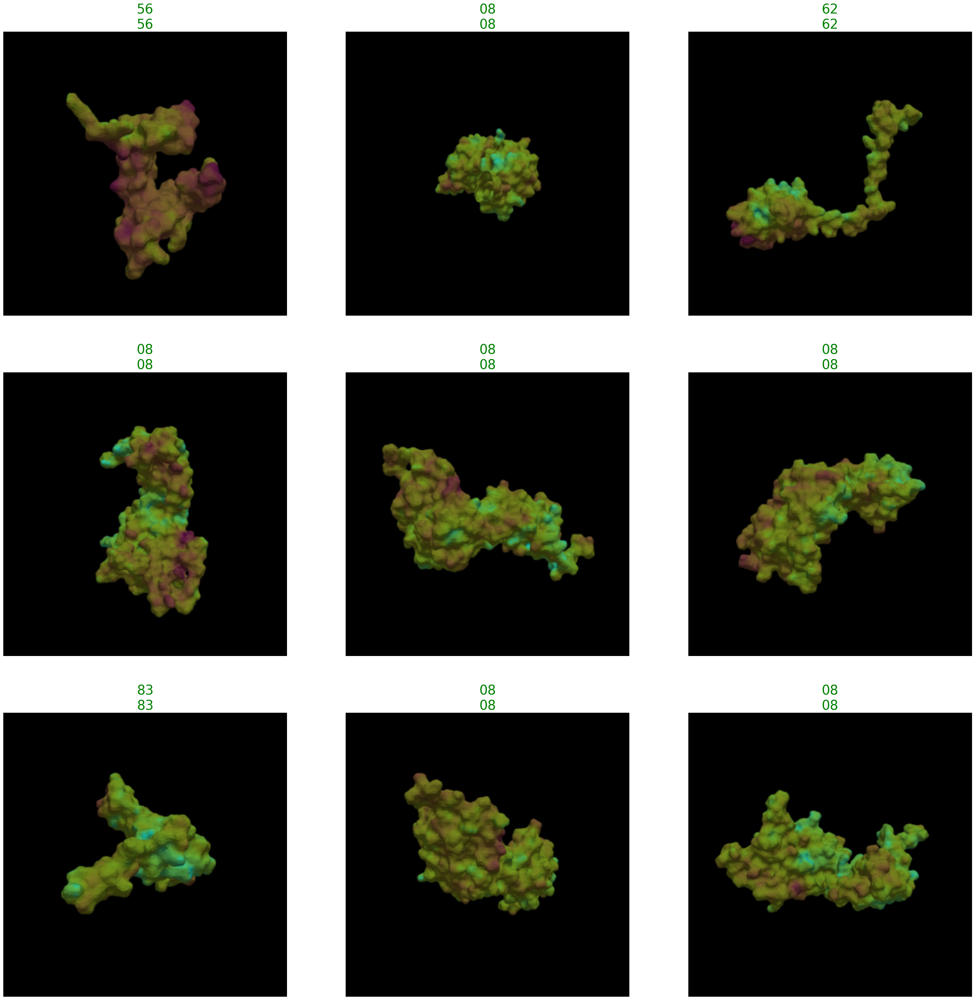

In [102]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


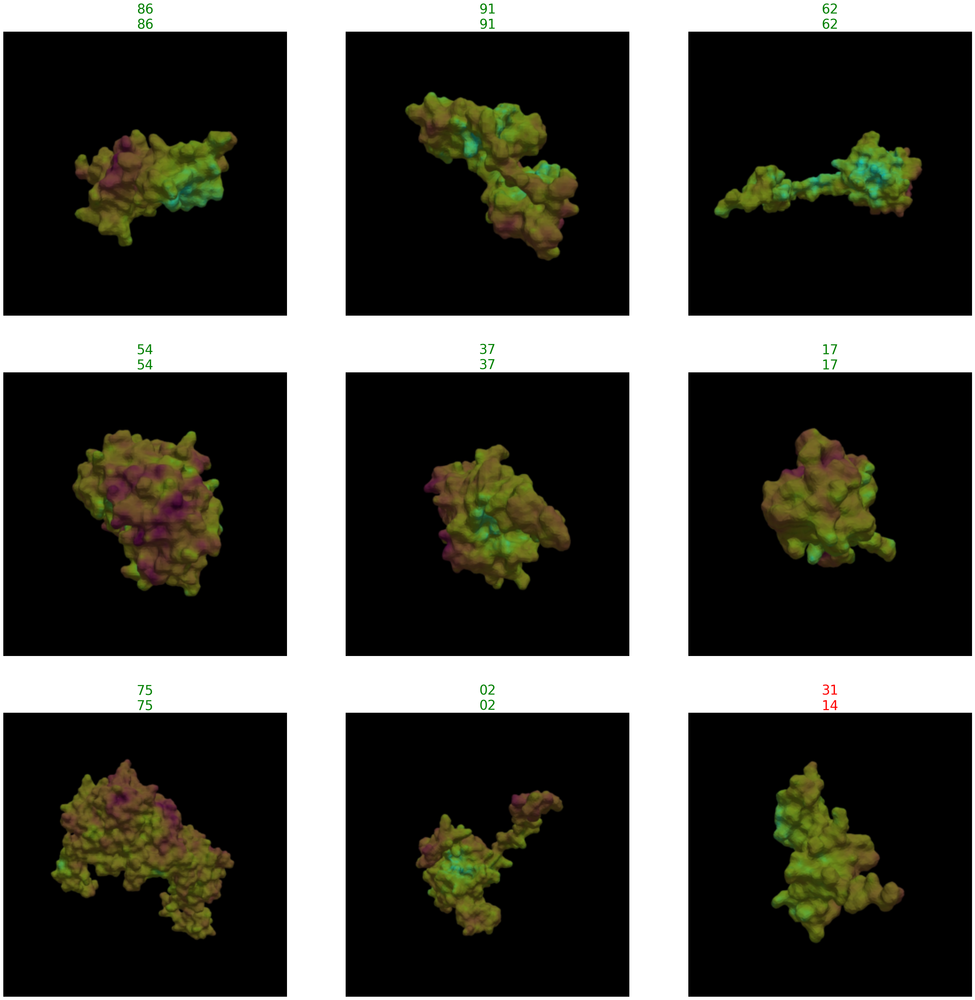

In [103]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


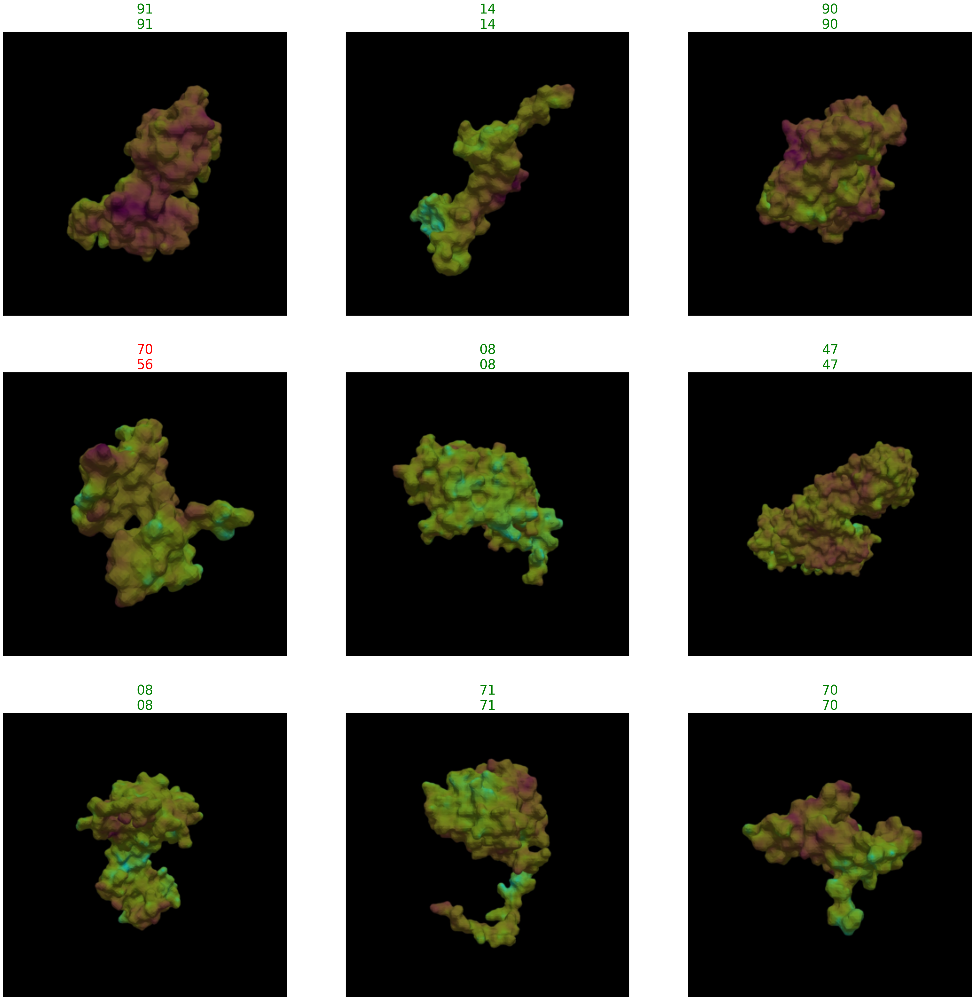

In [104]:
show_results(figsize=(38,38))

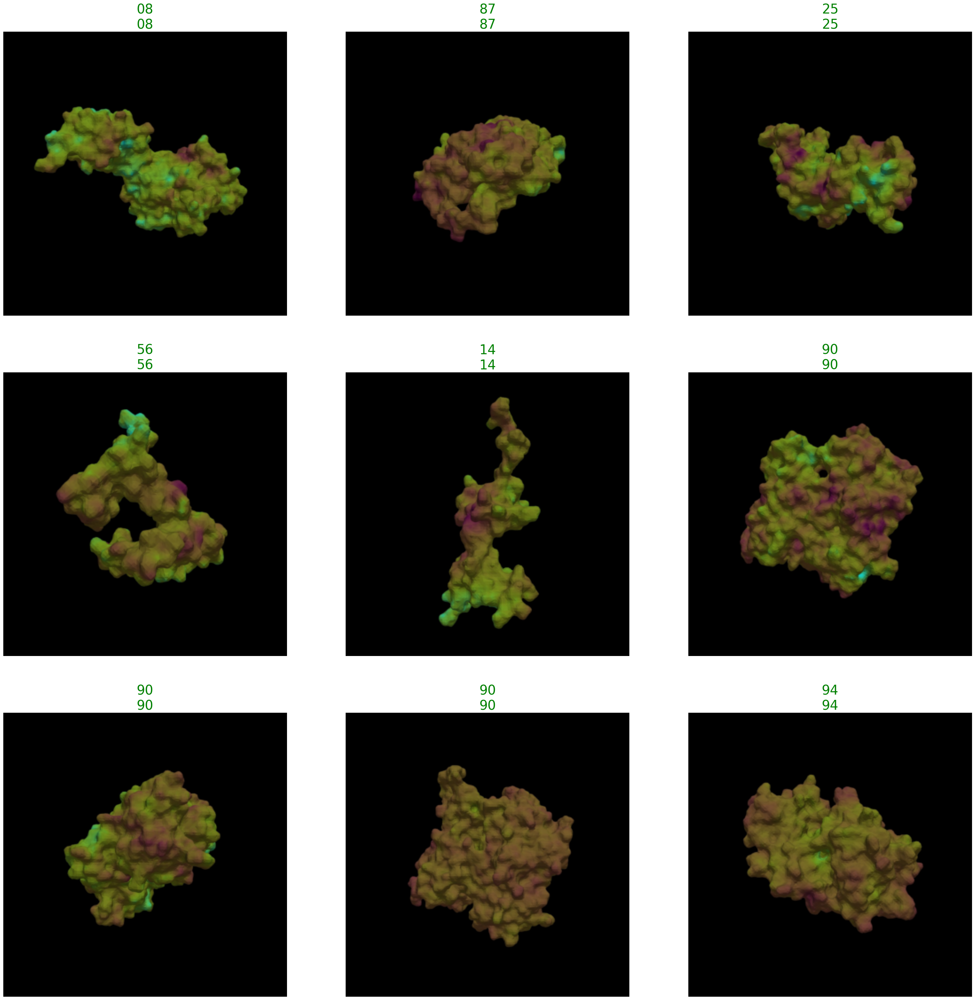

In [105]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


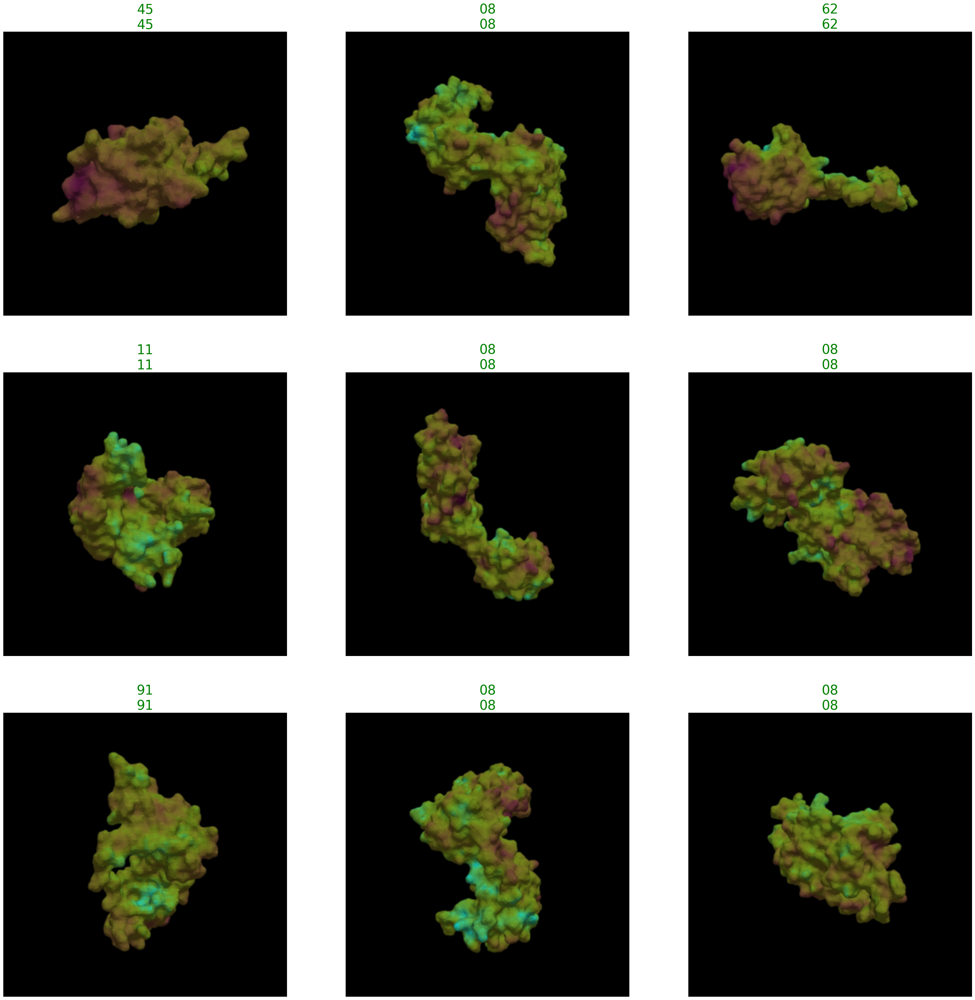

In [106]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


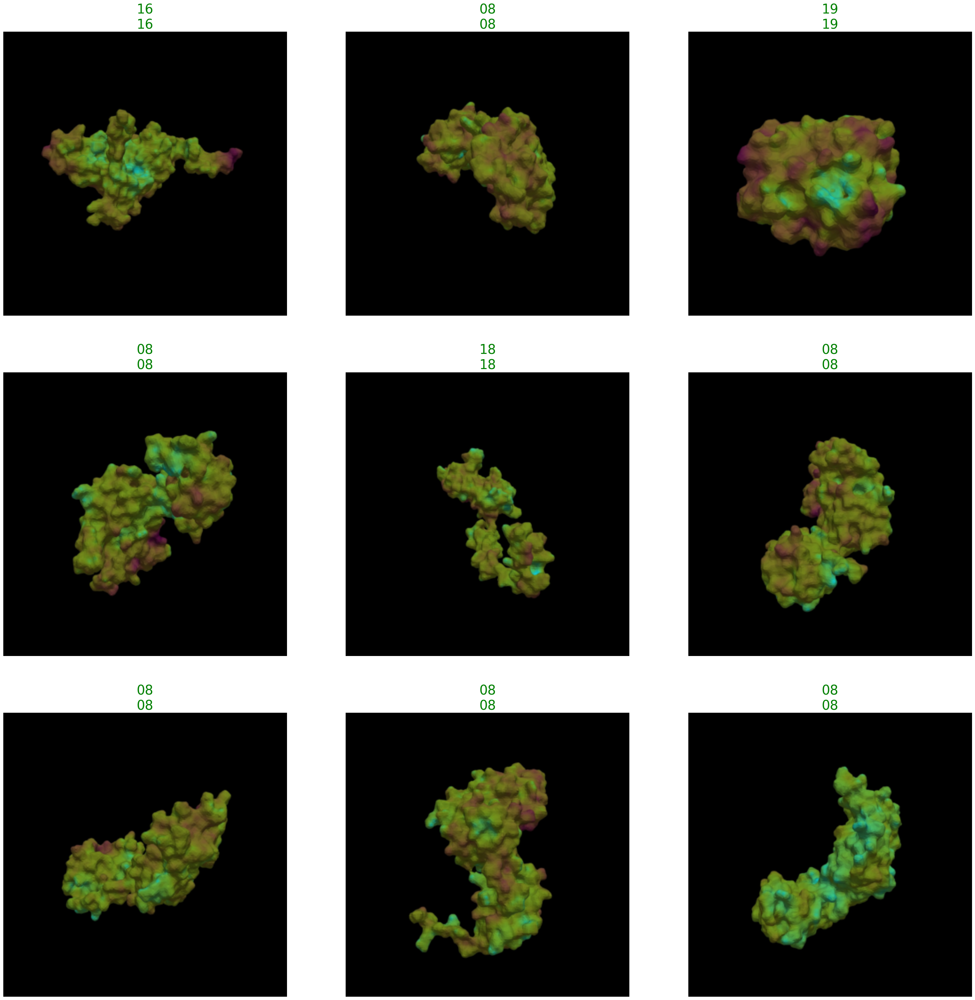

In [107]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


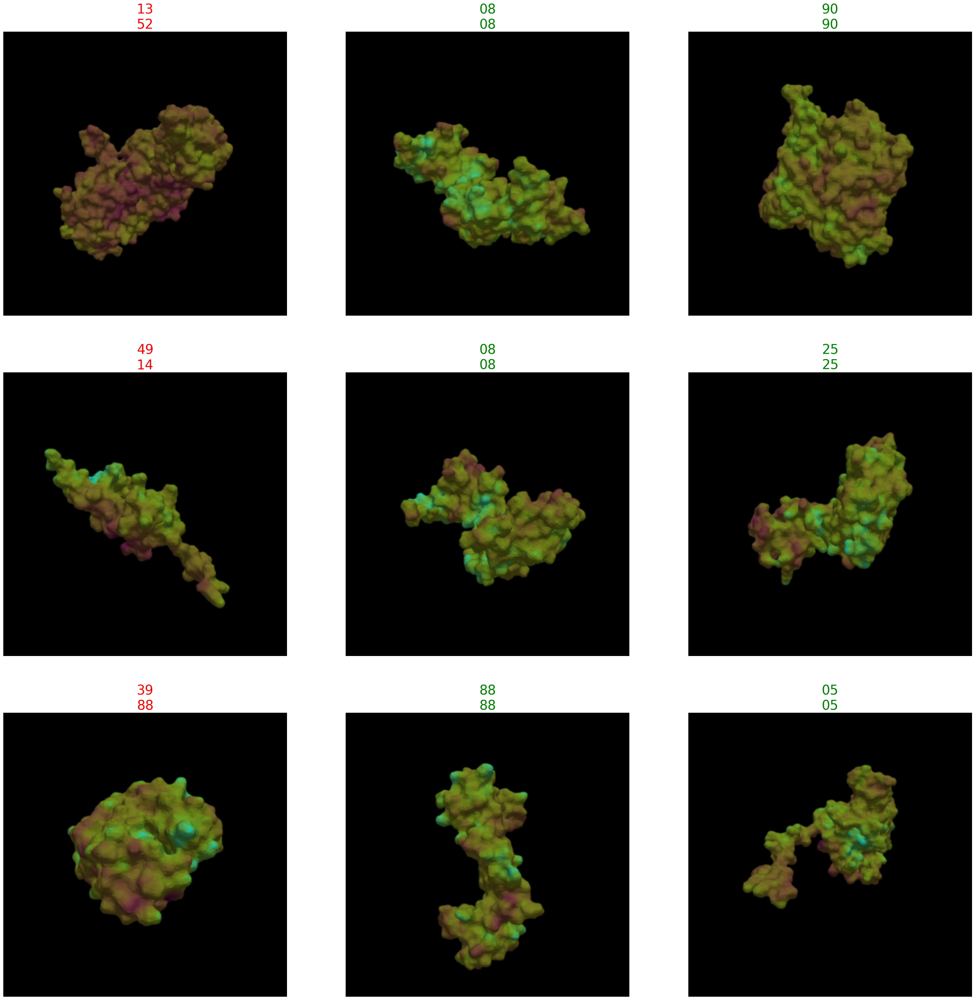

In [108]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


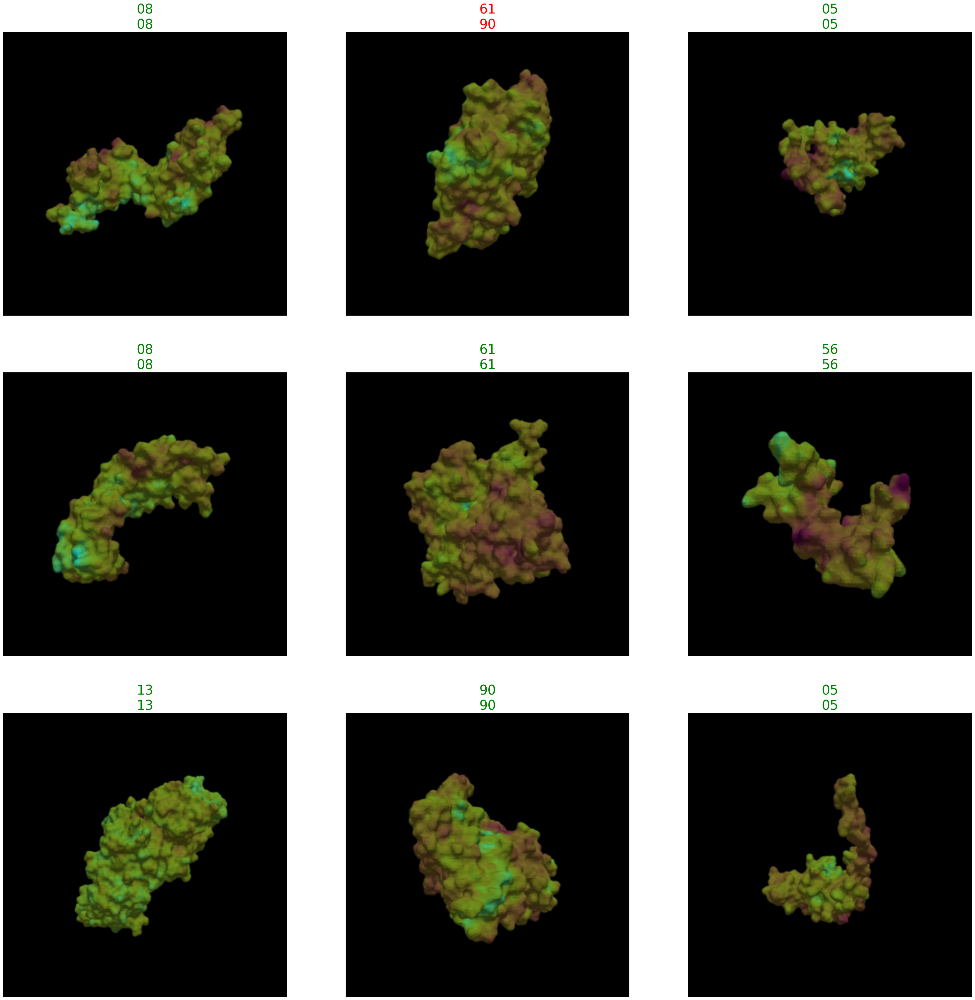

In [109]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


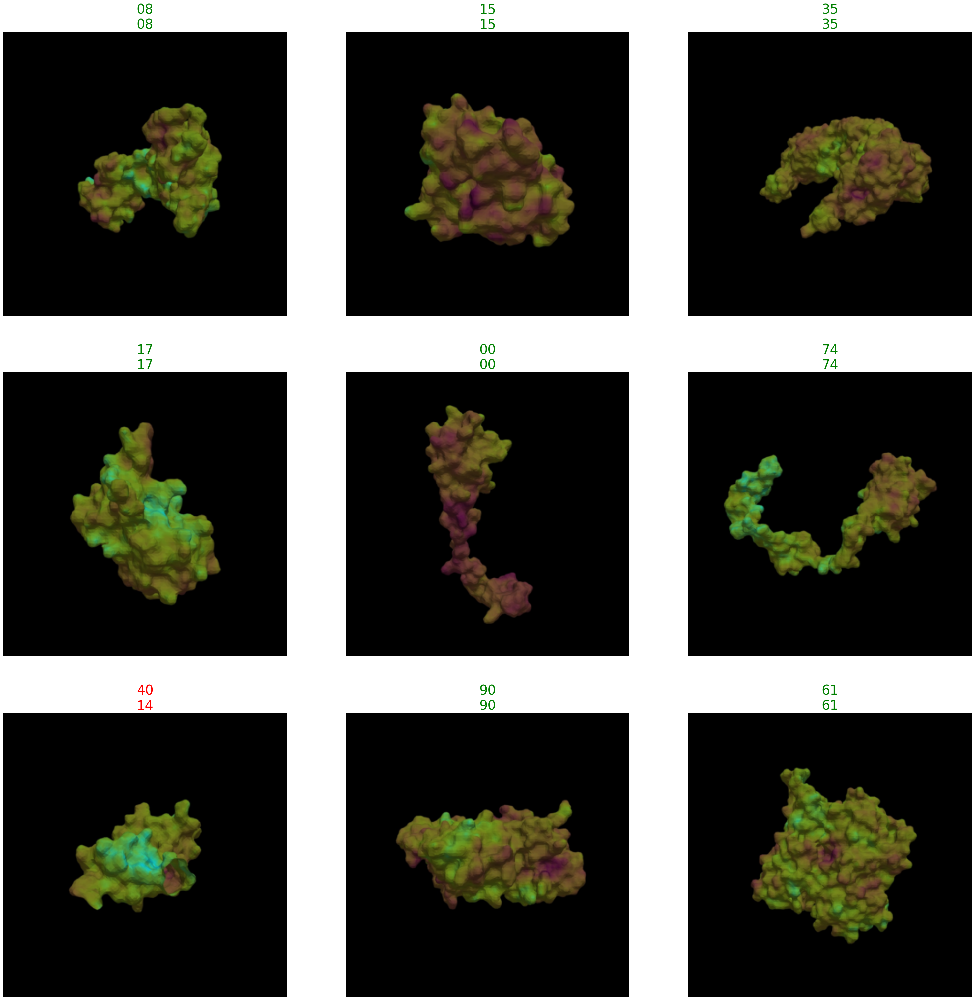

In [110]:
show_results(figsize=(38,38))

/mnt/raid1/venvs/sam2/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


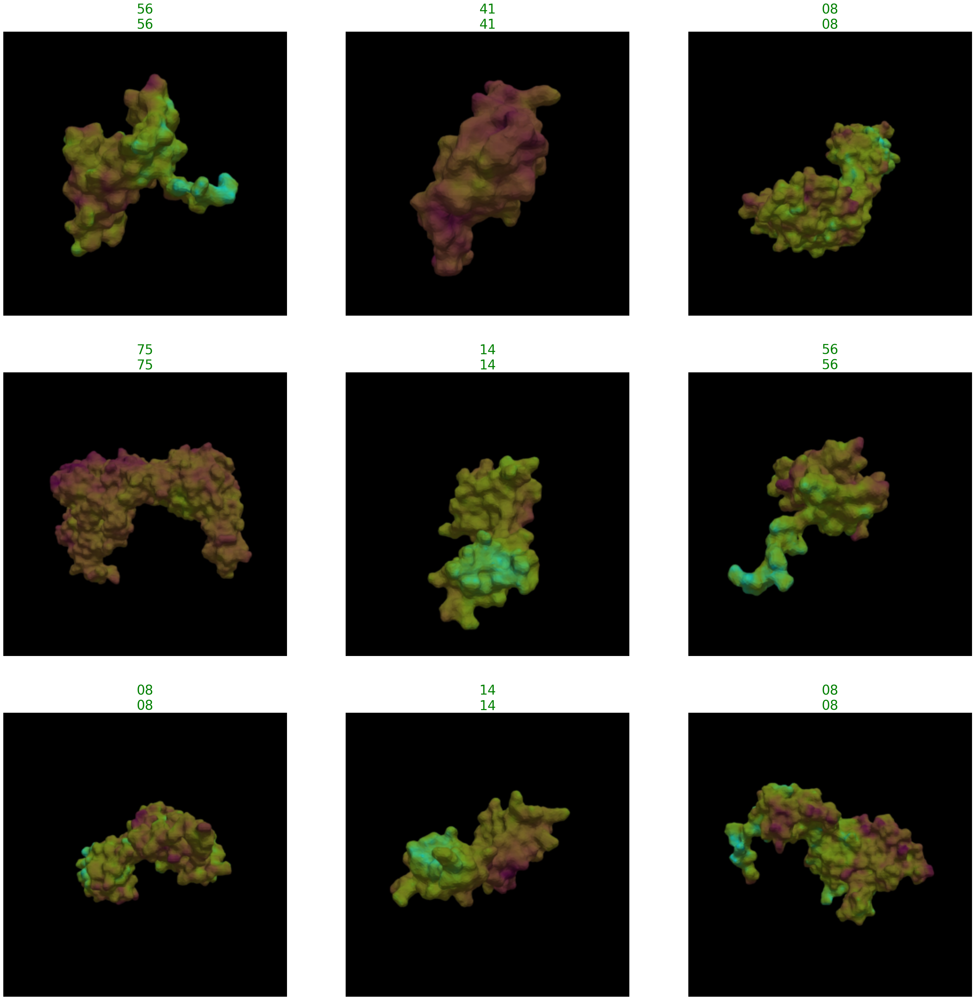

In [111]:
show_results(figsize=(38,38))